In [58]:
import math
import numpy as np
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression, Ridge, Lasso, ElasticNet
from sklearn.preprocessing import PolynomialFeatures,StandardScaler
from sklearn.pipeline import make_pipeline
from sklearn.metrics import mean_squared_error, r2_score,mean_absolute_error
from sklearn.model_selection import train_test_split
from sklearn.exceptions import ConvergenceWarning
import warnings

imports

In [44]:

import matplotlib.pyplot as plt

def my_sinc(x):
    if(x==0):
        return 1
    return math.sin(x)/x

part 1 this function gets x and returns sin(x)/x and if x is equal to 0 it returns 1

In [45]:

my_sinc_vectorized = np.vectorize(my_sinc)

x_100 = np.linspace(-15, 15, 100)
x_300 = np.linspace(-15, 15, 300)
x_1000 = np.linspace(-15, 15, 1000)

y_100 = my_sinc_vectorized(x_100)
y_300 = my_sinc_vectorized(x_300)
y_1000 = my_sinc_vectorized(x_1000)


part 2 yeknavakht sample with 100,300,1000 points between -15 and 15

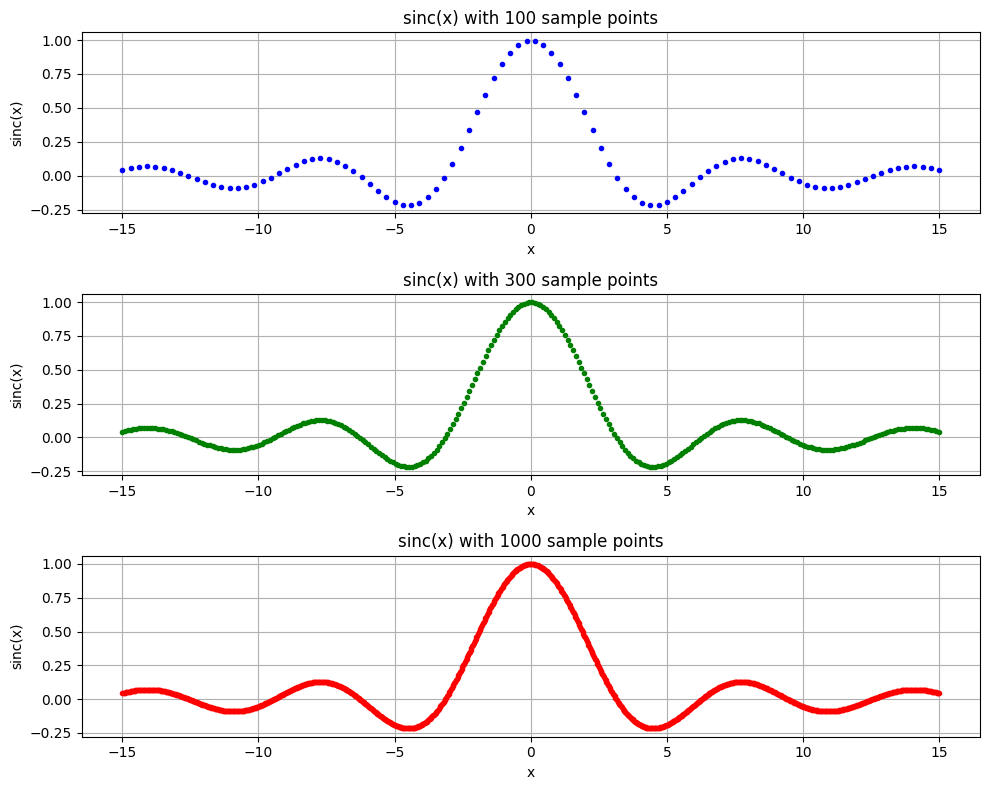

In [46]:

plt.figure(figsize=(10, 8))

plt.subplot(3, 1, 1)
plt.plot(x_100, y_100, '.', color='blue')
plt.title('sinc(x) with 100 sample points')
plt.xlabel('x')
plt.ylabel('sinc(x)')
plt.grid(True)

plt.subplot(3, 1, 2)
plt.plot(x_300, y_300, '.', color='green')
plt.title('sinc(x) with 300 sample points')
plt.xlabel('x')
plt.ylabel('sinc(x)')
plt.grid(True)

plt.subplot(3, 1, 3)
plt.plot(x_1000, y_1000, '.', color='red')
plt.title('sinc(x) with 1000 sample points')
plt.xlabel('x')
plt.ylabel('sinc(x)')
plt.grid(True)

plt.tight_layout()
plt.show()

what part 2 wants is shown

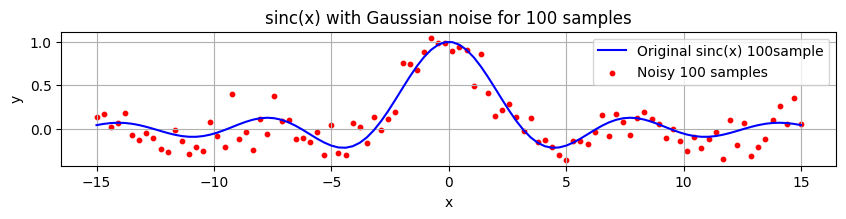

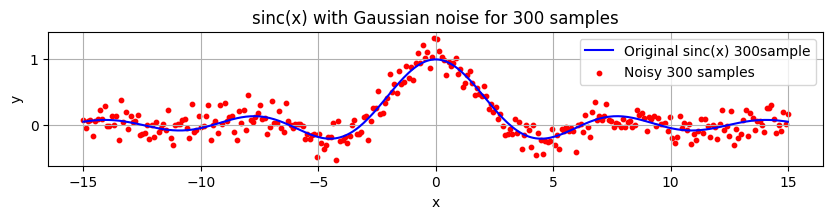

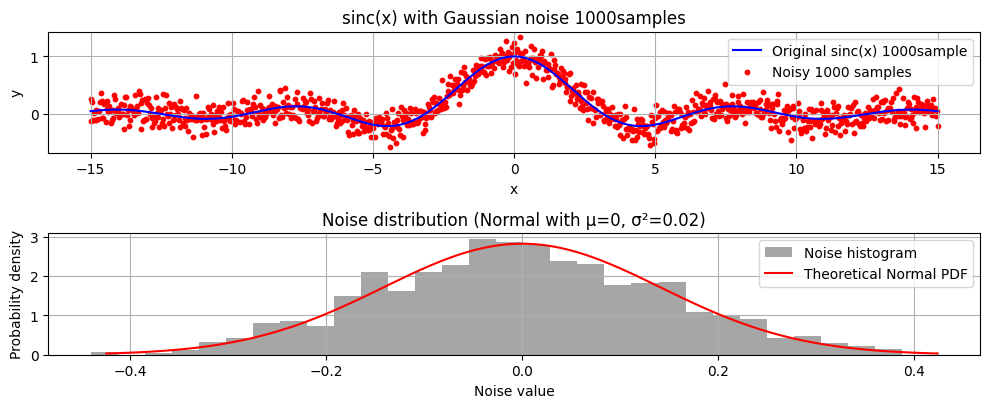

In [47]:

def add_normal_noise(y, mean=0, variance=0.02):
    noise = np.random.normal(mean, math.sqrt(variance), size=len(y))
    y_noisy = y + noise
    return y_noisy, noise

y100noisy, noise = add_normal_noise(y_100, mean=0, variance=0.02)

y300noisy, noise = add_normal_noise(y_300, mean=0, variance=0.02)

y1000noisy, noise = add_normal_noise(y_1000, mean=0, variance=0.02)

plt.figure(figsize=(10, 8))
plt.subplot(4, 1, 1)
plt.plot(x_100, y_100, label='Original sinc(x) 100sample', color='blue')
plt.scatter(x_100, y100noisy, label='Noisy 100 samples', color='red', s=10)
plt.title('sinc(x) with Gaussian noise for 100 samples')
plt.xlabel('x')
plt.ylabel('y')
plt.legend()
plt.grid(True)

plt.figure(figsize=(10, 8))
plt.subplot(4, 1, 1)
plt.plot(x_300, y_300, label='Original sinc(x) 300sample', color='blue')
plt.scatter(x_300, y300noisy, label='Noisy 300 samples', color='red', s=10)
plt.title('sinc(x) with Gaussian noise for 300 samples')
plt.xlabel('x')
plt.ylabel('y')
plt.legend()
plt.grid(True)

plt.figure(figsize=(10, 8))
plt.subplot(4, 1, 3)
plt.plot(x_1000, y_1000, label='Original sinc(x) 1000sample', color='blue')
plt.scatter(x_1000, y1000noisy, label='Noisy 1000 samples', color='red', s=10)
plt.title('sinc(x) with Gaussian noise 1000samples')
plt.xlabel('x')
plt.ylabel('y')
plt.legend()
plt.grid(True)

plt.subplot(4, 1, 4)
plt.hist(noise, bins=30, density=True, color='gray', alpha=0.7, label='Noise histogram')

mu, sigma = 0, math.sqrt(0.02)
x_norm = np.linspace(-3*sigma, 3*sigma, 100)
plt.plot(x_norm, (1/(sigma * np.sqrt(2*np.pi))) * np.exp(-x_norm**2 / (2*sigma**2)),
         color='red', label='Theoretical Normal PDF')

plt.title('Noise distribution (Normal with μ=0, σ²=0.02)')
plt.xlabel('Noise value')
plt.ylabel('Probability density')
plt.legend()
plt.grid(True)

plt.tight_layout()
plt.show()


part 3 now we have noisy and original y, noise mean is 0 and noise variance is 0.02

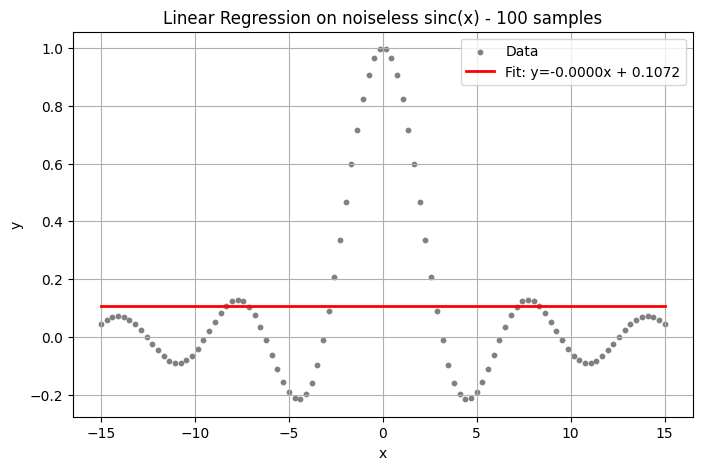

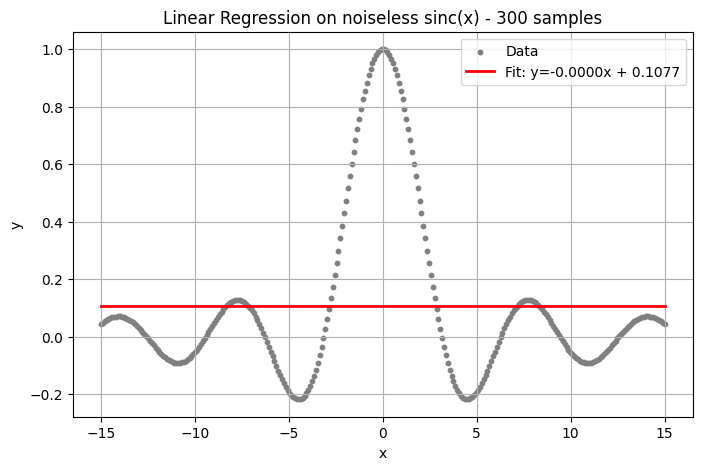

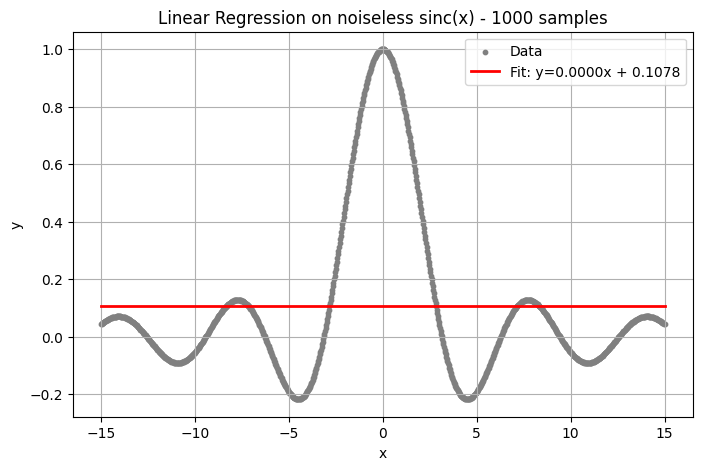

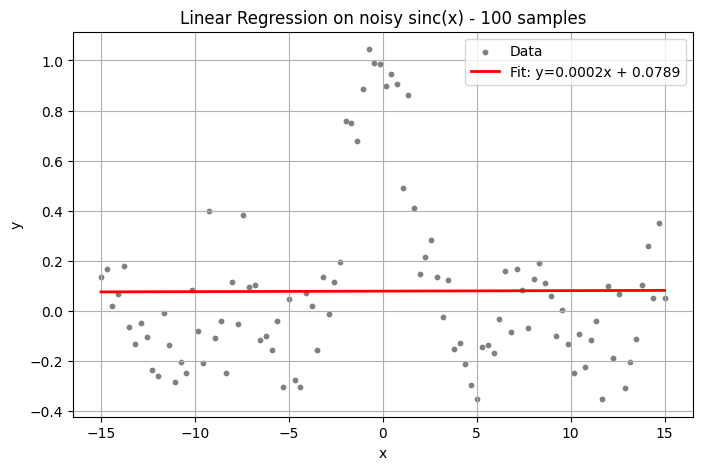

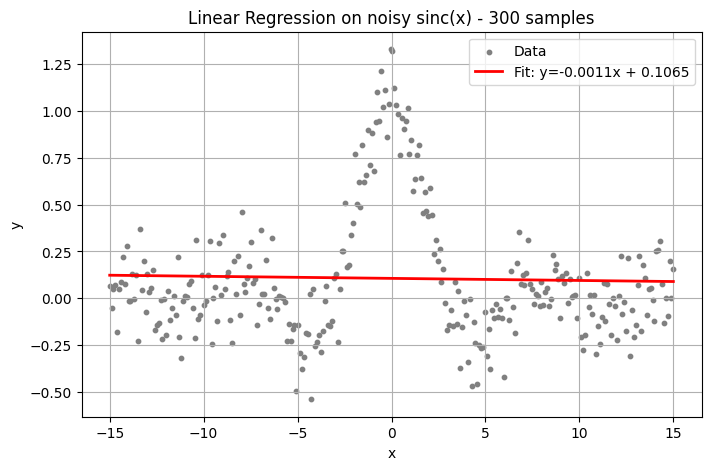

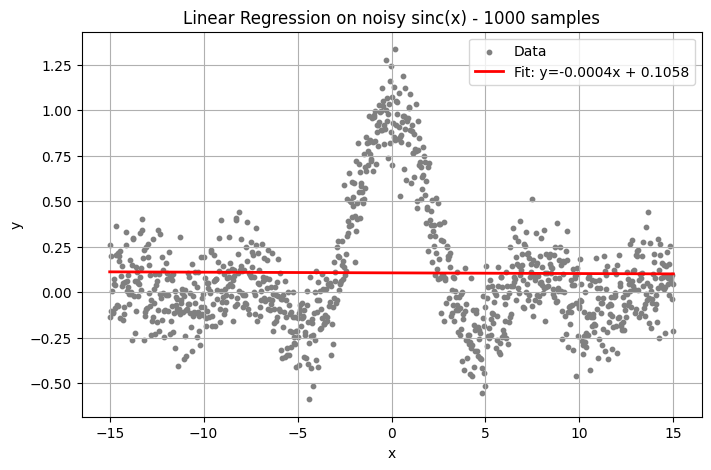

(np.float64(-0.0003736191508389804), np.float64(0.10582038271018414))

In [48]:
def linear_regression_fit(x, y, title):
    X = x.reshape(-1, 1)
    
    model = LinearRegression()
    model.fit(X, y)
    
    y_pred = model.predict(X)
    
    slope = model.coef_[0]
    intercept = model.intercept_
    
    plt.figure(figsize=(8, 5))
    plt.scatter(x, y, color='gray', s=10, label='Data')
    plt.plot(x, y_pred, color='red', linewidth=2, label=f'Fit: y={slope:.4f}x + {intercept:.4f}')
    plt.title(title)
    plt.xlabel('x')
    plt.ylabel('y')
    plt.legend()
    plt.grid(True)
    plt.show()
    
    return slope, intercept

linear_regression_fit(x_100, y_100, 'Linear Regression on noiseless sinc(x) - 100 samples')
linear_regression_fit(x_300, y_300, 'Linear Regression on noiseless sinc(x) - 300 samples')
linear_regression_fit(x_1000, y_1000, 'Linear Regression on noiseless sinc(x) - 1000 samples')

linear_regression_fit(x_100, y100noisy, 'Linear Regression on noisy sinc(x) - 100 samples')
linear_regression_fit(x_300, y300noisy, 'Linear Regression on noisy sinc(x) - 300 samples')
linear_regression_fit(x_1000, y1000noisy, 'Linear Regression on noisy sinc(x) - 1000 samples')

part 4.1 linear regression

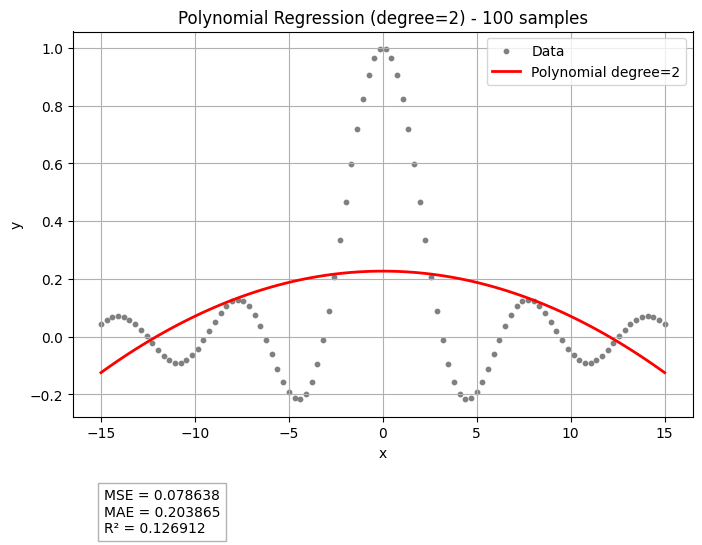

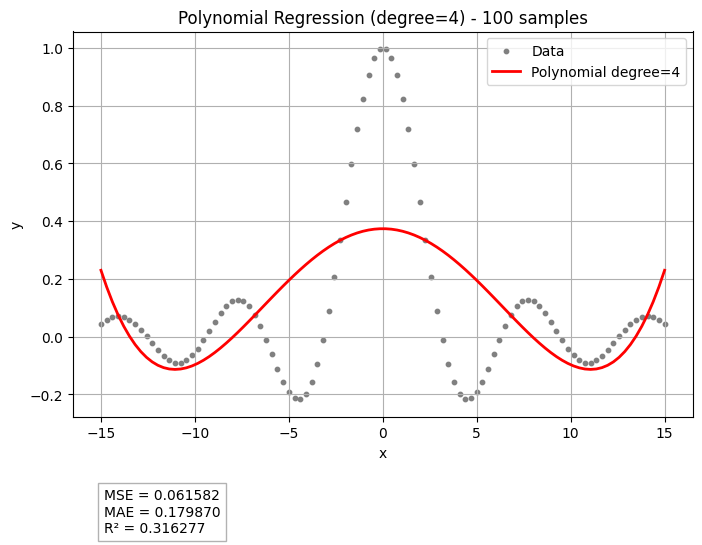

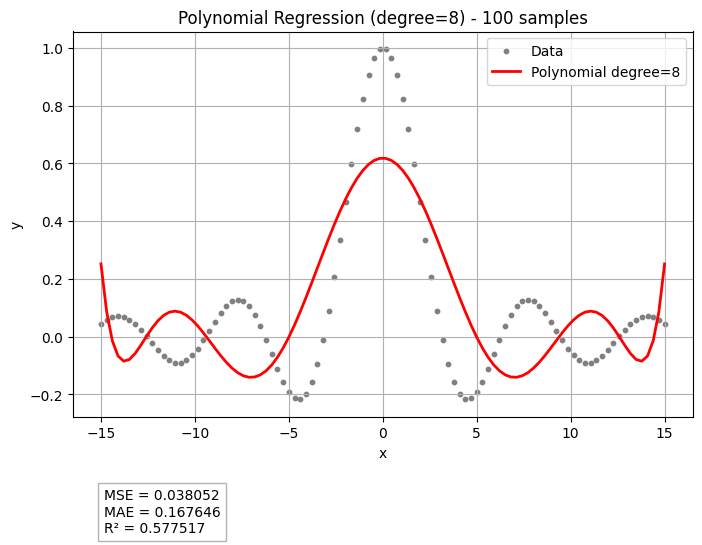

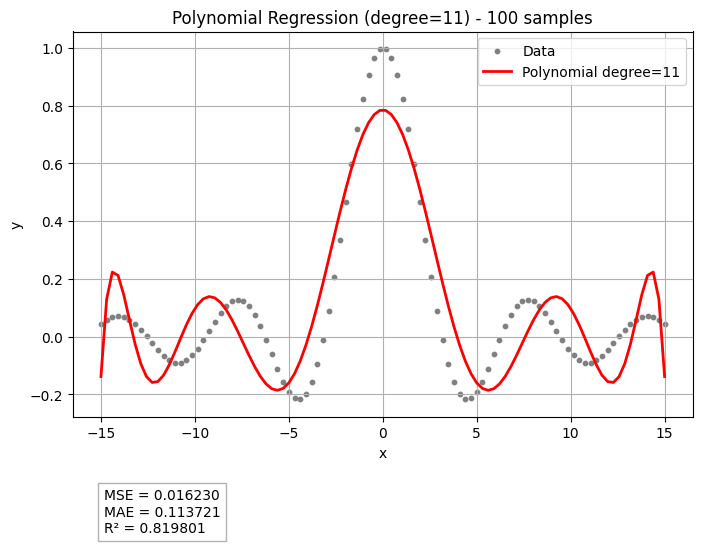

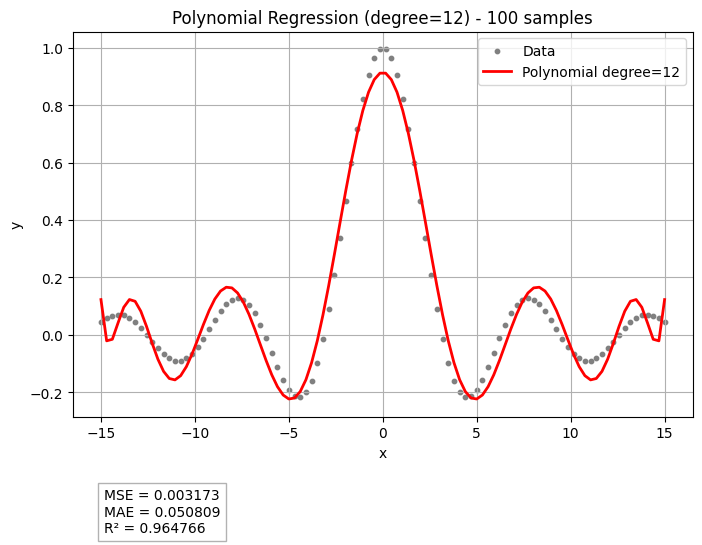

...

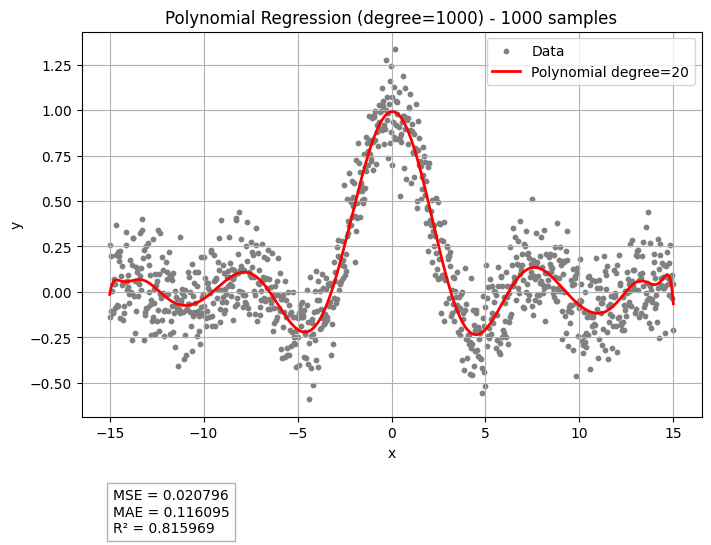

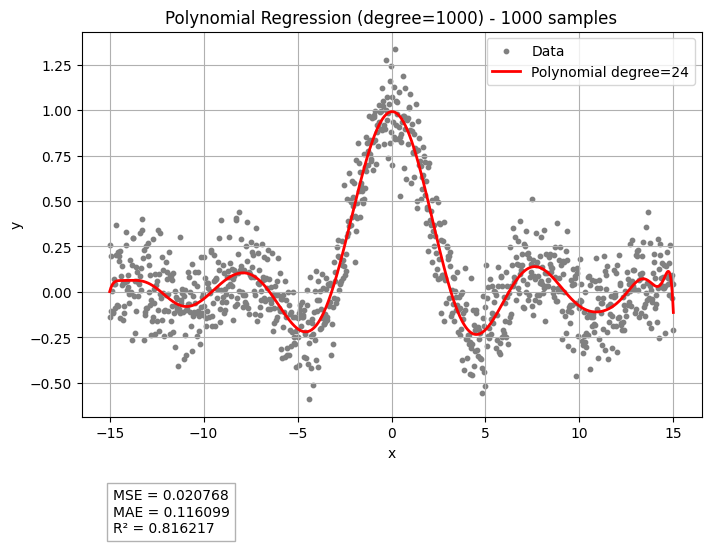

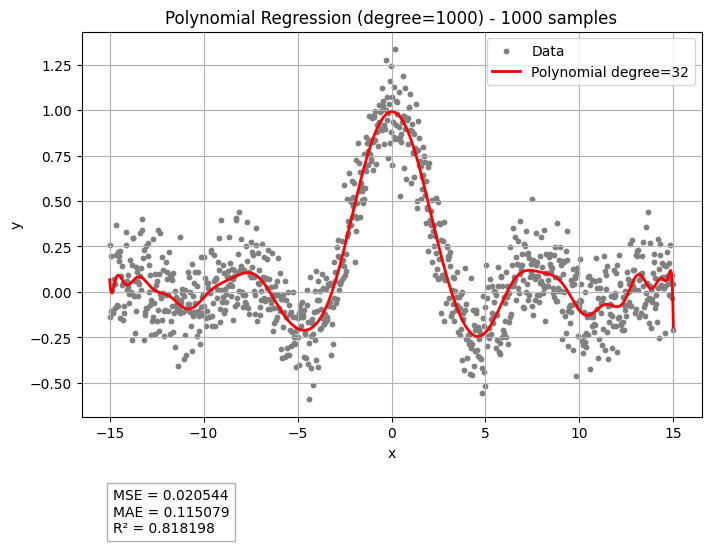

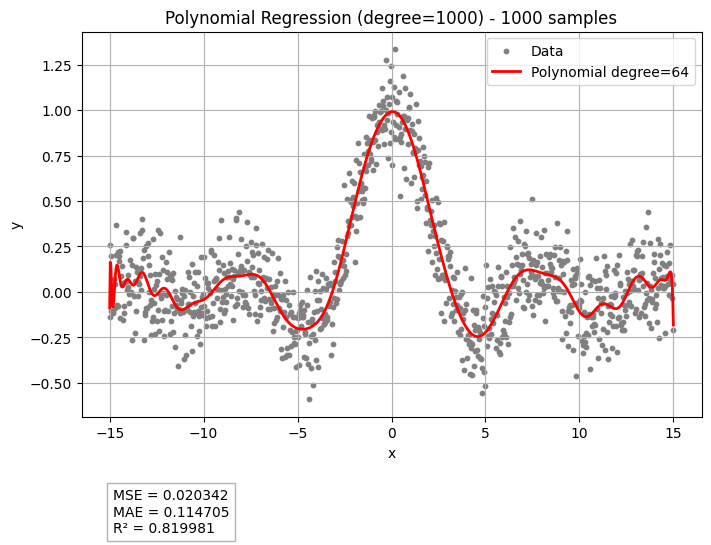

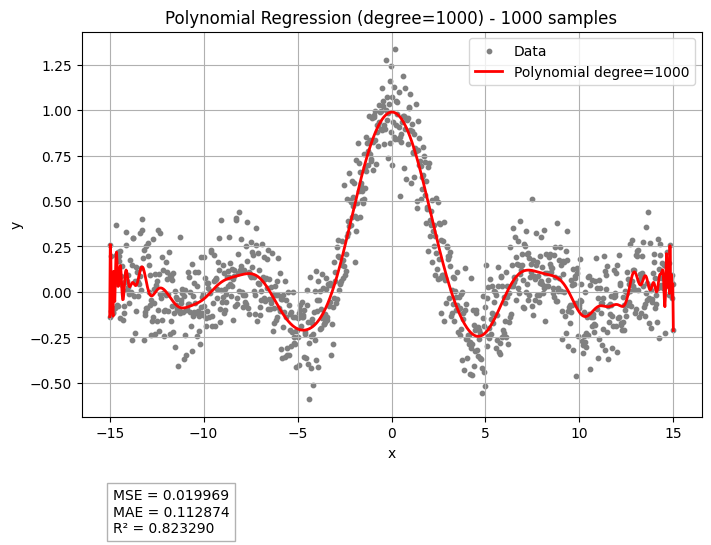

In [49]:
def polynomial_regression_fit(x, y, degree, title):
    x_scaled = x / np.max(np.abs(x))

    model = make_pipeline(PolynomialFeatures(degree), LinearRegression())
    model.fit(x_scaled.reshape(-1, 1), y)
    y_pred = model.predict(x_scaled.reshape(-1, 1))
    
    mse = mean_squared_error(y, y_pred)
    mae = mean_absolute_error(y, y_pred)
    r2 = r2_score(y, y_pred)
    
    plt.figure(figsize=(8, 5))
    plt.scatter(x, y, s=10, color='gray', label='Data')
    plt.plot(x, y_pred, color='red', linewidth=2, label=f'Polynomial degree={degree}')
    plt.title(title)
    plt.xlabel('x')
    plt.ylabel('y')
    plt.legend()
    plt.grid(True)

    plt.text(
            0.05, -0.30,
            f"MSE = {mse:.6f}\nMAE = {mae:.6f}\nR² = {r2:.6f}",
            transform=plt.gca().transAxes, fontsize=10,
            bbox=dict(facecolor='white', alpha=0.6, edgecolor='gray')
    )
    
    plt.show()

differentDegrees100 = [2, 4, 8, 11, 12,13, 16, 20, 24, 32, 64 ,100]
for deg in differentDegrees100:
    polynomial_regression_fit(x_100, y_100, deg, f'Polynomial Regression (degree={deg}) - 100 samples')

for deg in differentDegrees100:
    polynomial_regression_fit(x_100, y100noisy, deg, f'Polynomial Regression (degree={deg}) - 100 samples')

differentDegrees300 = [2, 4, 8, 11, 12,13, 16, 20, 24, 32, 64 ,300]
for deg in differentDegrees300:
    polynomial_regression_fit(x_300, y_300, deg, 'Polynomial Regression (degree=300) - 300 samples')

for deg in differentDegrees300:
    polynomial_regression_fit(x_300,y300noisy, deg, 'Polynomial Regression (degree=300) - 300 samples')

differentDegrees1000 = [2, 4, 8, 11, 12,13, 16, 20, 24, 32, 64 ,1000]
for deg in differentDegrees1000:
    polynomial_regression_fit(x_1000, y_1000, deg, 'Polynomial Regression (degree=1000) - 1000 samples')
    
for deg in differentDegrees1000:
    polynomial_regression_fit(x_1000, y1000noisy, deg, 'Polynomial Regression (degree=1000) - 1000 samples')

part 4.2 polynomial regression model

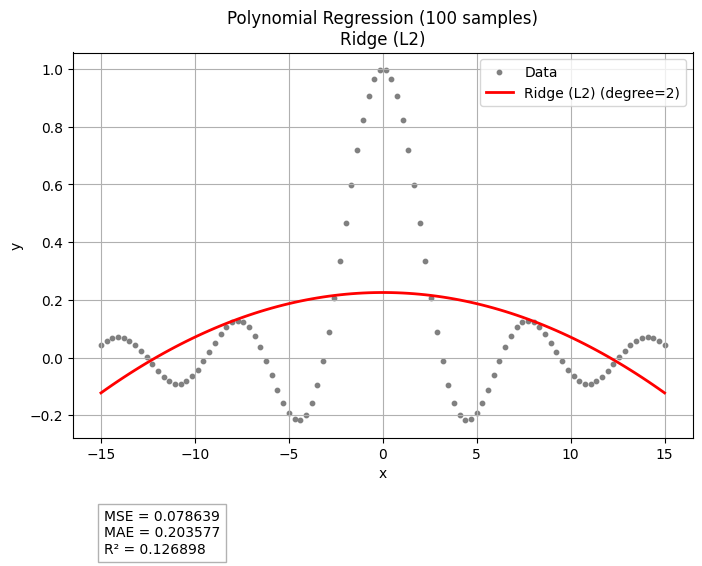

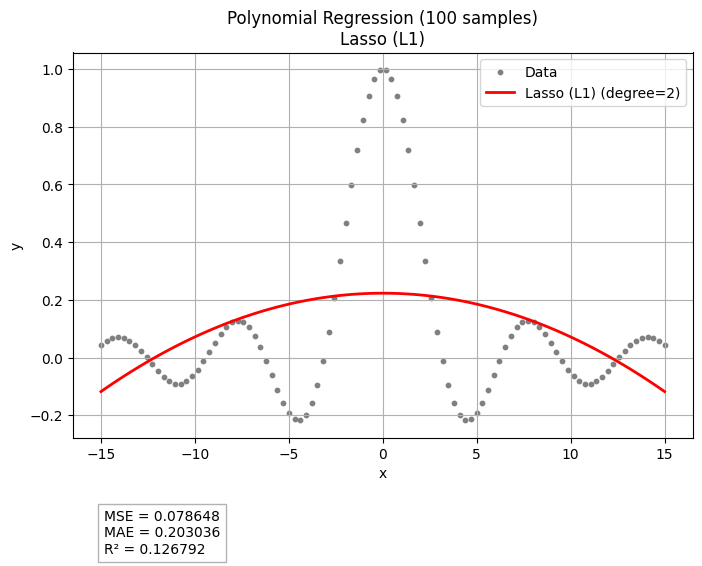

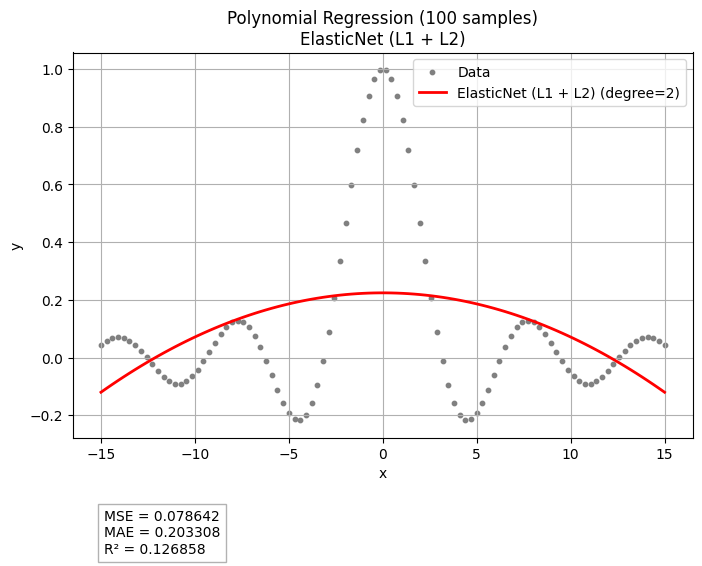

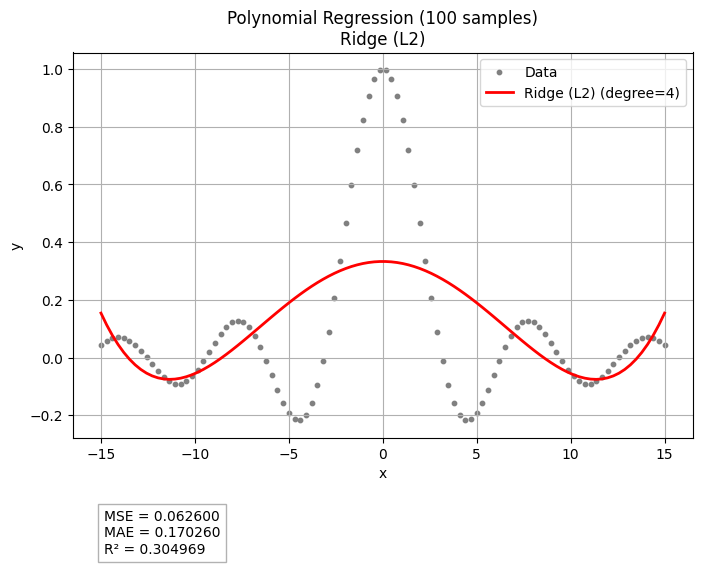

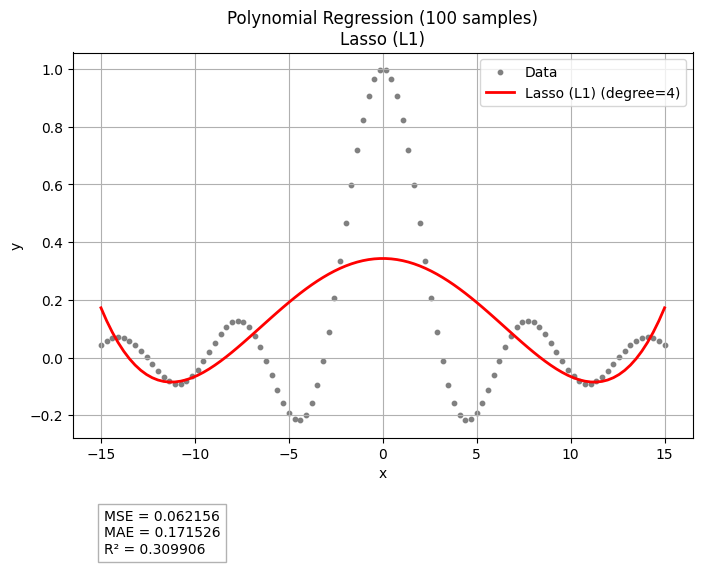

...

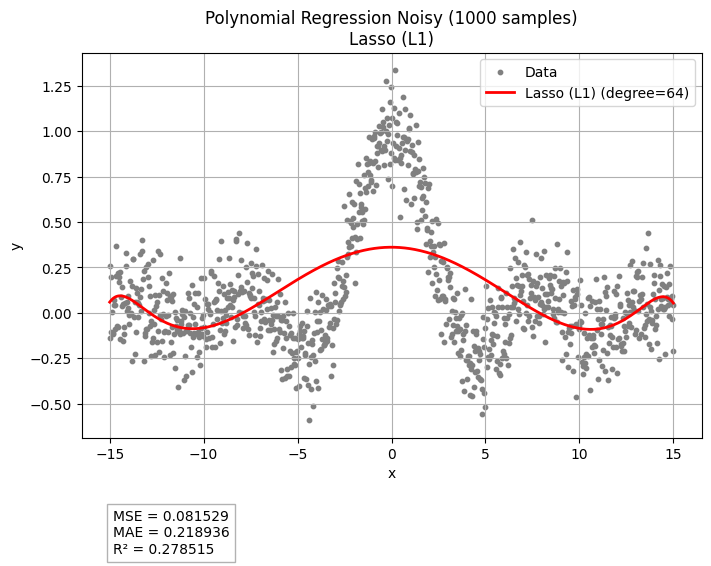

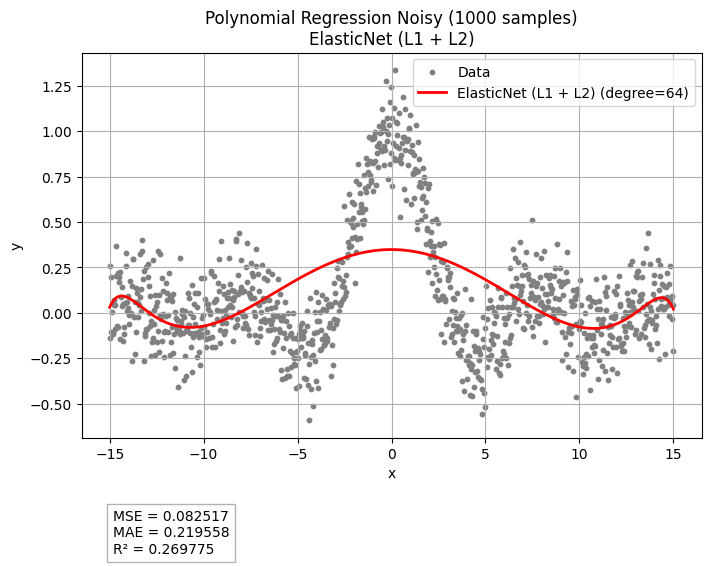

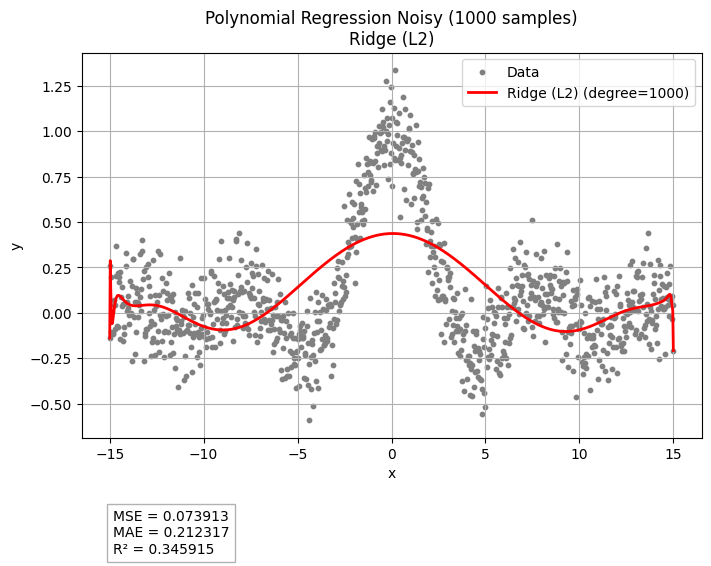

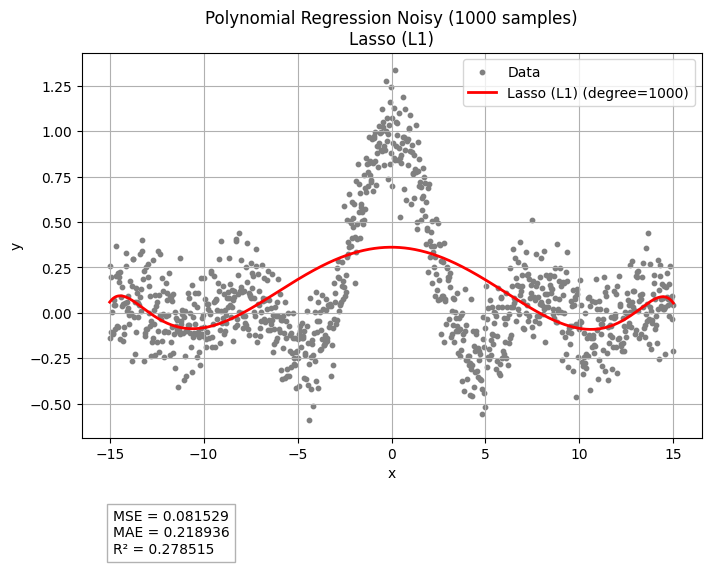

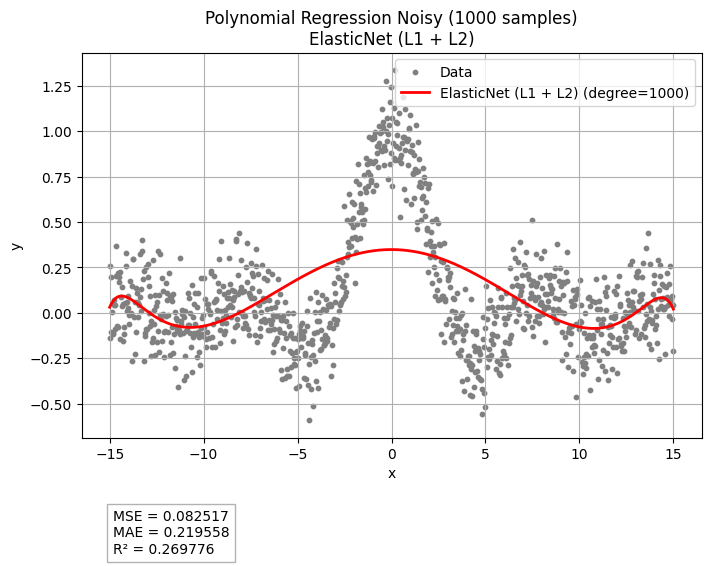

In [50]:
def poly_reg_with_regularization(x, y, degree, title):
    x_scaled = x / np.max(np.abs(x))
    
    models = {
        #"Linear": LinearRegression(),
        "Ridge (L2)": Ridge(alpha=0.1),
        "Lasso (L1)": Lasso(alpha=0.001, max_iter=5000),
        "ElasticNet (L1 + L2)": ElasticNet(alpha=0.001, l1_ratio=0.5, max_iter=5000)
    }

    for model_name, reg in models.items():

        model = make_pipeline(PolynomialFeatures(degree), reg)
        model.fit(x_scaled.reshape(-1, 1), y)
        y_pred = model.predict(x_scaled.reshape(-1, 1))

        mse = mean_squared_error(y, y_pred)
        mae = mean_absolute_error(y, y_pred)
        r2 = r2_score(y, y_pred)

        plt.figure(figsize=(8, 5))
        plt.scatter(x, y, s=10, color='gray', label='Data')
        plt.plot(x, y_pred, color='red', linewidth=2,
                 label=f'{model_name} (degree={degree})')

        plt.title(f'{title}\n{model_name}')
        plt.xlabel('x')
        plt.ylabel('y')
        plt.legend()
        plt.grid(True)

        plt.text(
            0.05, -0.30,
            f"MSE = {mse:.6f}\nMAE = {mae:.6f}\nR² = {r2:.6f}",
            transform=plt.gca().transAxes, fontsize=10,
            bbox=dict(facecolor='white', alpha=0.6, edgecolor='gray')
        )

        plt.show()


for deg in differentDegrees100:
    poly_reg_with_regularization(x_100, y_100, deg,
                                 f'Polynomial Regression (100 samples)')

for deg in differentDegrees100:
    poly_reg_with_regularization(x_100, y100noisy, deg,
                                 f'Polynomial Regression Noisy (100 samples)')

for deg in differentDegrees300:
    poly_reg_with_regularization(x_300, y_300, deg,
                                 f'Polynomial Regression (300 samples)')

for deg in differentDegrees300:
    poly_reg_with_regularization(x_300, y300noisy, deg,
                                 f'Polynomial Regression Noisy (300 samples)')

for deg in differentDegrees1000:
    poly_reg_with_regularization(x_1000, y_1000, deg,
                                 f'Polynomial Regression (1000 samples)')

for deg in differentDegrees1000:
    poly_reg_with_regularization(x_1000, y1000noisy, deg,
                                 f'Polynomial Regression Noisy (1000 samples)')


part 4.3 polynomial regression with multiple regularization methods (Linear, Ridge, Lasso, ElasticNet)


--- Analyzing 100_noiseless


c:\Users\MOSALAS\AppData\Local\Programs\Python\Python314\Lib\site-packages\sklearn\linear_model\_coordinate_descent.py:695: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.457e+00, tolerance: 7.146e-04
  model = cd_fast.enet_coordinate_descent(
c:\Users\MOSALAS\AppData\Local\Programs\Python\Python314\Lib\site-packages\sklearn\linear_model\_coordinate_descent.py:695: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.303e+00, tolerance: 7.146e-04
  model = cd_fast.enet_coordinate_descent(
c:\Users\MOSALAS\AppData\Local\Programs\Python\Python314\Lib\site-packages\sklearn\linear_model\_coordinate_descent.py:695: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check t

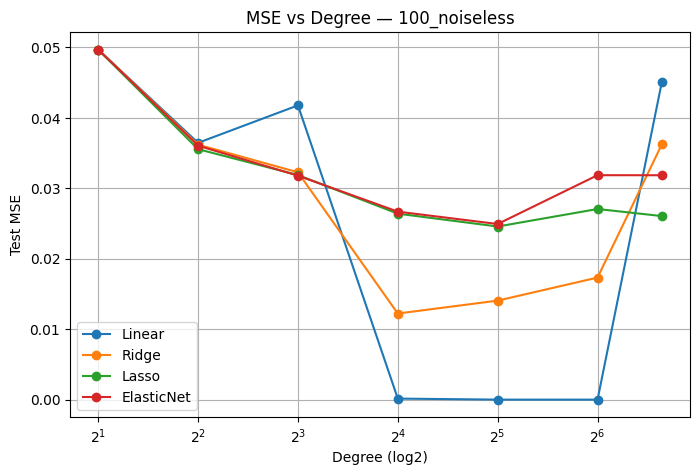

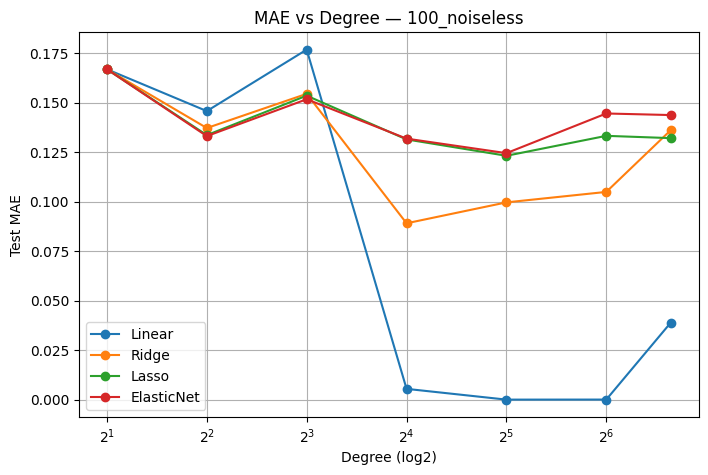

c:\Users\MOSALAS\AppData\Local\Programs\Python\Python314\Lib\site-packages\sklearn\linear_model\_coordinate_descent.py:695: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.288e+00, tolerance: 7.146e-04
  model = cd_fast.enet_coordinate_descent(
c:\Users\MOSALAS\AppData\Local\Programs\Python\Python314\Lib\site-packages\sklearn\linear_model\_coordinate_descent.py:695: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.208e+00, tolerance: 7.146e-04
  model = cd_fast.enet_coordinate_descent(
c:\Users\MOSALAS\AppData\Local\Programs\Python\Python314\Lib\site-packages\sklearn\linear_model\_coordinate_descent.py:695: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check t

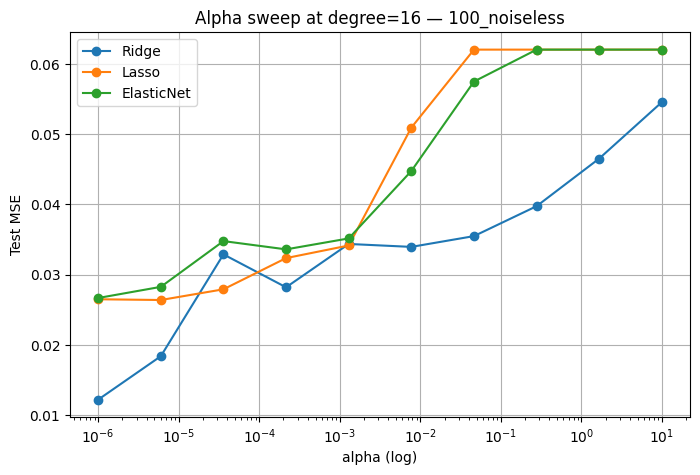

Summary (best per model): 100_noiseless
Linear: best degree=32, MSE=1.621859e-17, MAE=7.472904e-10
Ridge: best degree=16, alpha=1e-06, MSE=1.222072e-02, MAE=8.903724e-02
Lasso: best degree=32, alpha=1e-06, MSE=2.457260e-02, MAE=1.231189e-01
ElasticNet: best degree=32, alpha=1e-06, MSE=2.492655e-02, MAE=1.244447e-01
Breakpoint (heuristic) for Linear: 8
Breakpoint (heuristic) for Ridge: 32
Breakpoint (heuristic) for Lasso: 64
Breakpoint (heuristic) for ElasticNet: 64

--- Analyzing 100_noisy


c:\Users\MOSALAS\AppData\Local\Programs\Python\Python314\Lib\site-packages\sklearn\linear_model\_coordinate_descent.py:695: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.840e+00, tolerance: 8.842e-04
  model = cd_fast.enet_coordinate_descent(
c:\Users\MOSALAS\AppData\Local\Programs\Python\Python314\Lib\site-packages\sklearn\linear_model\_coordinate_descent.py:695: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.676e+00, tolerance: 8.842e-04
  model = cd_fast.enet_coordinate_descent(
c:\Users\MOSALAS\AppData\Local\Programs\Python\Python314\Lib\site-packages\sklearn\linear_model\_coordinate_descent.py:695: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check t

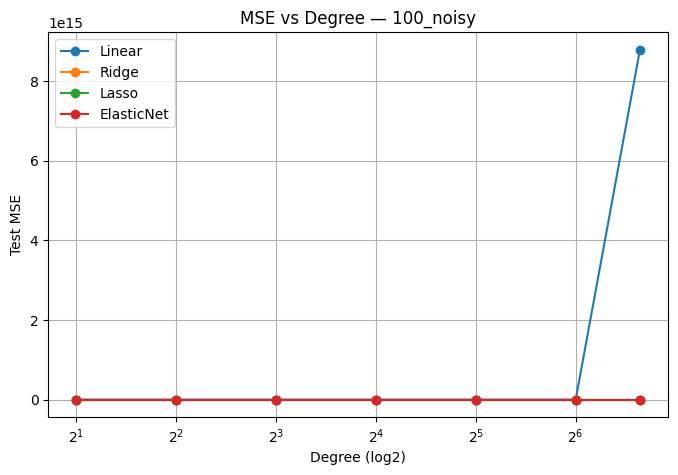

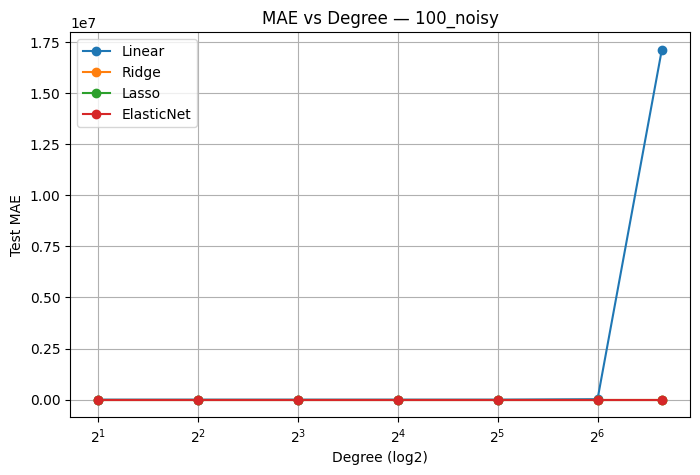

c:\Users\MOSALAS\AppData\Local\Programs\Python\Python314\Lib\site-packages\sklearn\linear_model\_coordinate_descent.py:695: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.655e+00, tolerance: 8.842e-04
  model = cd_fast.enet_coordinate_descent(
c:\Users\MOSALAS\AppData\Local\Programs\Python\Python314\Lib\site-packages\sklearn\linear_model\_coordinate_descent.py:695: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.559e+00, tolerance: 8.842e-04
  model = cd_fast.enet_coordinate_descent(
c:\Users\MOSALAS\AppData\Local\Programs\Python\Python314\Lib\site-packages\sklearn\linear_model\_coordinate_descent.py:695: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check t

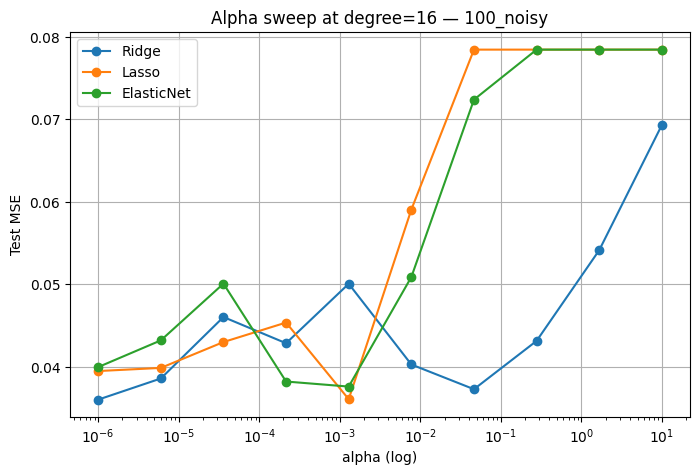

Summary (best per model): 100_noisy
Linear: best degree=16, MSE=3.087759e-02, MAE=1.427419e-01
Ridge: best degree=4, alpha=1e-06, MSE=3.477877e-02, MAE=1.610058e-01
Lasso: best degree=4, alpha=1e-06, MSE=3.477878e-02, MAE=1.610080e-01
ElasticNet: best degree=4, alpha=1e-06, MSE=3.477995e-02, MAE=1.610109e-01
Breakpoint (heuristic) for Linear: 8
Breakpoint (heuristic) for Ridge: 8
Breakpoint (heuristic) for Lasso: 8
Breakpoint (heuristic) for ElasticNet: 8

--- Analyzing 300_noiseless


c:\Users\MOSALAS\AppData\Local\Programs\Python\Python314\Lib\site-packages\sklearn\linear_model\_coordinate_descent.py:695: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.703e+00, tolerance: 2.072e-03
  model = cd_fast.enet_coordinate_descent(
c:\Users\MOSALAS\AppData\Local\Programs\Python\Python314\Lib\site-packages\sklearn\linear_model\_coordinate_descent.py:695: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.155e+00, tolerance: 2.072e-03
  model = cd_fast.enet_coordinate_descent(
c:\Users\MOSALAS\AppData\Local\Programs\Python\Python314\Lib\site-packages\sklearn\linear_model\_coordinate_descent.py:695: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check t

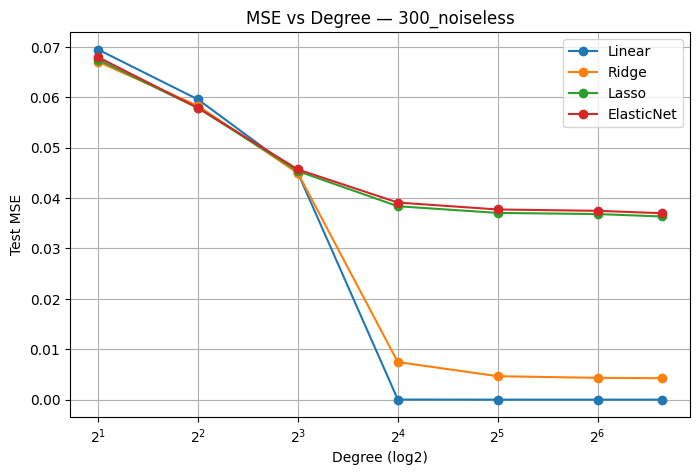

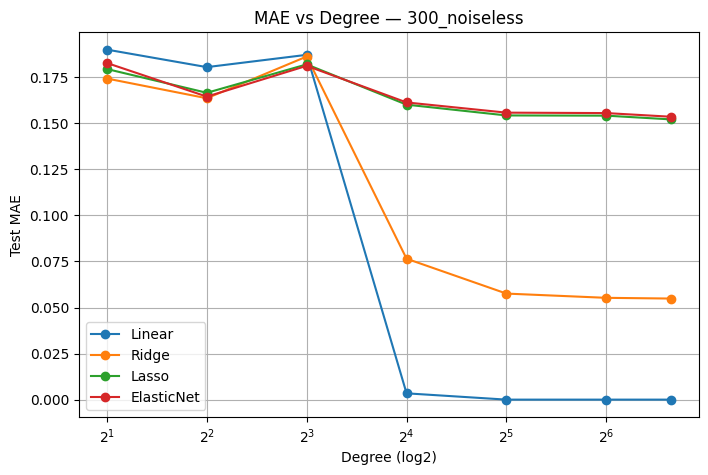

c:\Users\MOSALAS\AppData\Local\Programs\Python\Python314\Lib\site-packages\sklearn\linear_model\_coordinate_descent.py:695: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.221e+00, tolerance: 2.072e-03
  model = cd_fast.enet_coordinate_descent(
c:\Users\MOSALAS\AppData\Local\Programs\Python\Python314\Lib\site-packages\sklearn\linear_model\_coordinate_descent.py:695: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.957e+00, tolerance: 2.072e-03
  model = cd_fast.enet_coordinate_descent(
c:\Users\MOSALAS\AppData\Local\Programs\Python\Python314\Lib\site-packages\sklearn\linear_model\_coordinate_descent.py:695: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check t

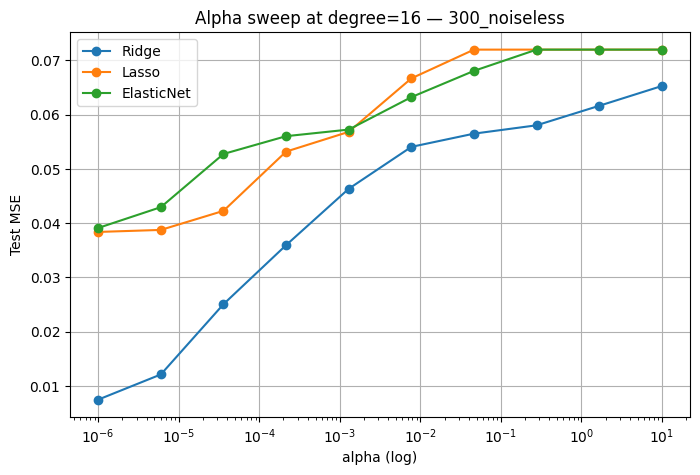

Summary (best per model): 300_noiseless
Linear: best degree=32, MSE=3.552351e-22, MAE=1.590189e-11
Ridge: best degree=100, alpha=1e-06, MSE=4.250056e-03, MAE=5.486599e-02
Lasso: best degree=100, alpha=1e-06, MSE=3.634898e-02, MAE=1.521264e-01
ElasticNet: best degree=100, alpha=1e-06, MSE=3.699391e-02, MAE=1.535672e-01
Breakpoint (heuristic) for Linear: 64
Breakpoint (heuristic) for Ridge: None
Breakpoint (heuristic) for Lasso: 64
Breakpoint (heuristic) for ElasticNet: 64

--- Analyzing 300_noisy


c:\Users\MOSALAS\AppData\Local\Programs\Python\Python314\Lib\site-packages\sklearn\linear_model\_coordinate_descent.py:695: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.489e+00, tolerance: 2.669e-03
  model = cd_fast.enet_coordinate_descent(
c:\Users\MOSALAS\AppData\Local\Programs\Python\Python314\Lib\site-packages\sklearn\linear_model\_coordinate_descent.py:695: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.569e+00, tolerance: 2.669e-03
  model = cd_fast.enet_coordinate_descent(
c:\Users\MOSALAS\AppData\Local\Programs\Python\Python314\Lib\site-packages\sklearn\linear_model\_coordinate_descent.py:695: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check t

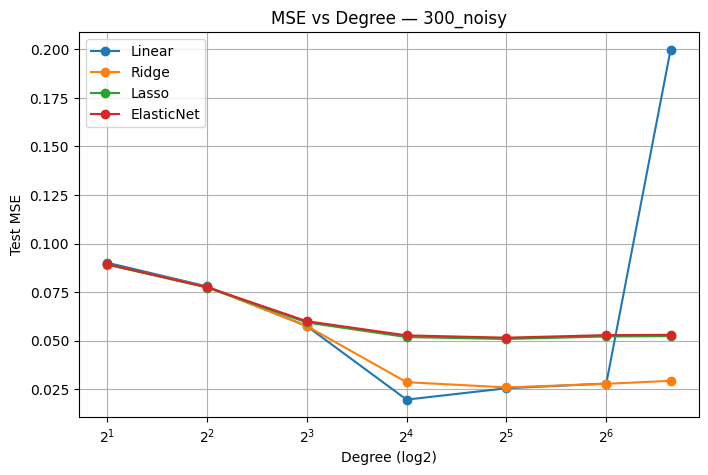

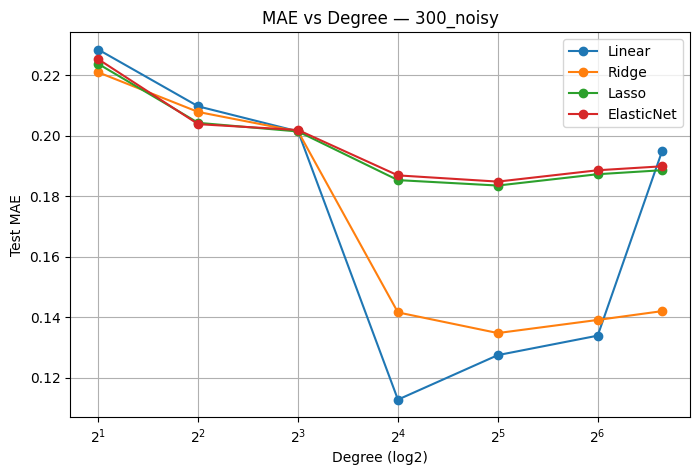

c:\Users\MOSALAS\AppData\Local\Programs\Python\Python314\Lib\site-packages\sklearn\linear_model\_coordinate_descent.py:695: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.877e+00, tolerance: 2.669e-03
  model = cd_fast.enet_coordinate_descent(
c:\Users\MOSALAS\AppData\Local\Programs\Python\Python314\Lib\site-packages\sklearn\linear_model\_coordinate_descent.py:695: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.399e+00, tolerance: 2.669e-03
  model = cd_fast.enet_coordinate_descent(
c:\Users\MOSALAS\AppData\Local\Programs\Python\Python314\Lib\site-packages\sklearn\linear_model\_coordinate_descent.py:695: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check t

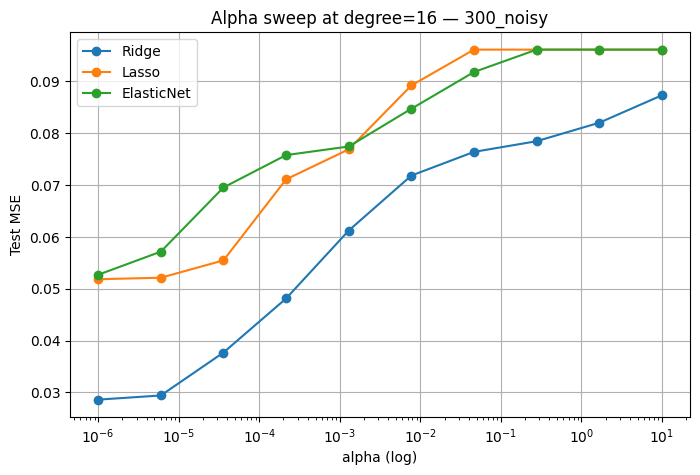

Summary (best per model): 300_noisy
Linear: best degree=16, MSE=1.962325e-02, MAE=1.127294e-01
Ridge: best degree=32, alpha=1e-06, MSE=2.591419e-02, MAE=1.347457e-01
Lasso: best degree=32, alpha=1e-06, MSE=5.085122e-02, MAE=1.835399e-01
ElasticNet: best degree=32, alpha=1e-06, MSE=5.153119e-02, MAE=1.848407e-01
Breakpoint (heuristic) for Linear: 32
Breakpoint (heuristic) for Ridge: 64
Breakpoint (heuristic) for Lasso: 64
Breakpoint (heuristic) for ElasticNet: 64

--- Analyzing 1000_noiseless


c:\Users\MOSALAS\AppData\Local\Programs\Python\Python314\Lib\site-packages\sklearn\linear_model\_coordinate_descent.py:695: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.318e+01, tolerance: 6.294e-03
  model = cd_fast.enet_coordinate_descent(
c:\Users\MOSALAS\AppData\Local\Programs\Python\Python314\Lib\site-packages\sklearn\linear_model\_coordinate_descent.py:695: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.117e+01, tolerance: 6.294e-03
  model = cd_fast.enet_coordinate_descent(
c:\Users\MOSALAS\AppData\Local\Programs\Python\Python314\Lib\site-packages\sklearn\linear_model\_coordinate_descent.py:695: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check t

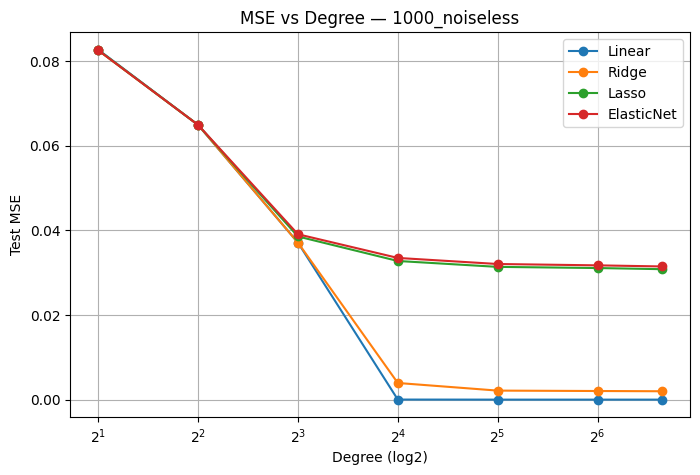

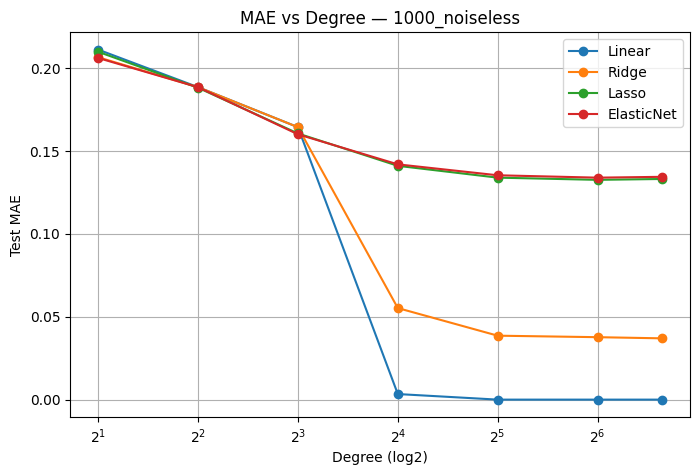

c:\Users\MOSALAS\AppData\Local\Programs\Python\Python314\Lib\site-packages\sklearn\linear_model\_coordinate_descent.py:695: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.134e+01, tolerance: 6.294e-03
  model = cd_fast.enet_coordinate_descent(
c:\Users\MOSALAS\AppData\Local\Programs\Python\Python314\Lib\site-packages\sklearn\linear_model\_coordinate_descent.py:695: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.042e+01, tolerance: 6.294e-03
  model = cd_fast.enet_coordinate_descent(
c:\Users\MOSALAS\AppData\Local\Programs\Python\Python314\Lib\site-packages\sklearn\linear_model\_coordinate_descent.py:695: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check t

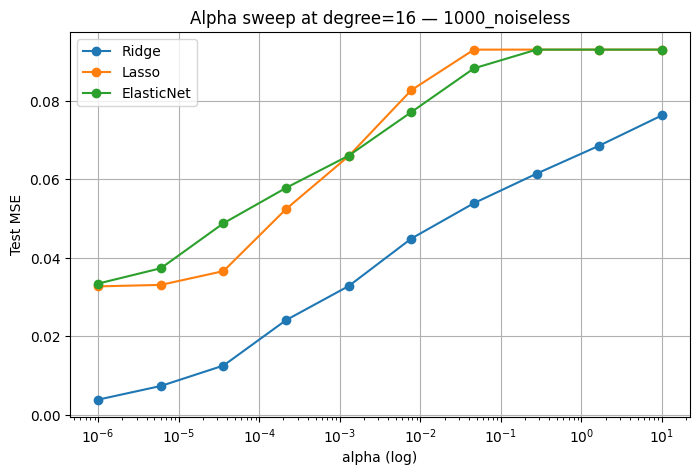

Summary (best per model): 1000_noiseless
Linear: best degree=32, MSE=2.871667e-22, MAE=1.470815e-11
Ridge: best degree=100, alpha=1e-06, MSE=1.977182e-03, MAE=3.694443e-02
Lasso: best degree=100, alpha=1e-06, MSE=3.081908e-02, MAE=1.330056e-01
ElasticNet: best degree=100, alpha=1e-06, MSE=3.146443e-02, MAE=1.343079e-01
Breakpoint (heuristic) for Linear: 64
Breakpoint (heuristic) for Ridge: None
Breakpoint (heuristic) for Lasso: 64
Breakpoint (heuristic) for ElasticNet: 64

--- Analyzing 1000_noisy


c:\Users\MOSALAS\AppData\Local\Programs\Python\Python314\Lib\site-packages\sklearn\linear_model\_coordinate_descent.py:695: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.996e+01, tolerance: 7.739e-03
  model = cd_fast.enet_coordinate_descent(
c:\Users\MOSALAS\AppData\Local\Programs\Python\Python314\Lib\site-packages\sklearn\linear_model\_coordinate_descent.py:695: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.682e+01, tolerance: 7.739e-03
  model = cd_fast.enet_coordinate_descent(
c:\Users\MOSALAS\AppData\Local\Programs\Python\Python314\Lib\site-packages\sklearn\linear_model\_coordinate_descent.py:695: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check t

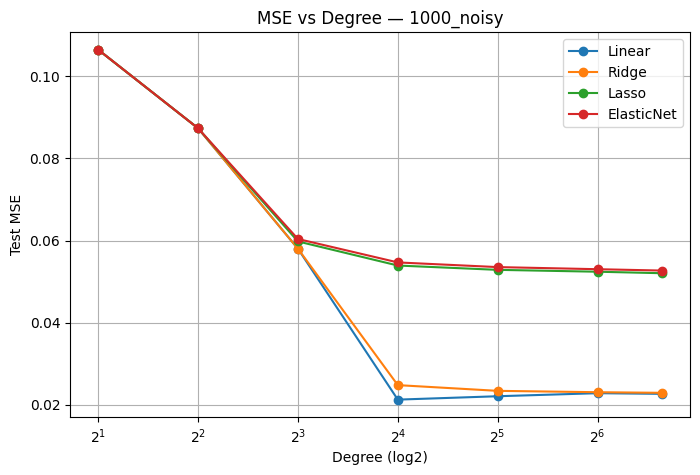

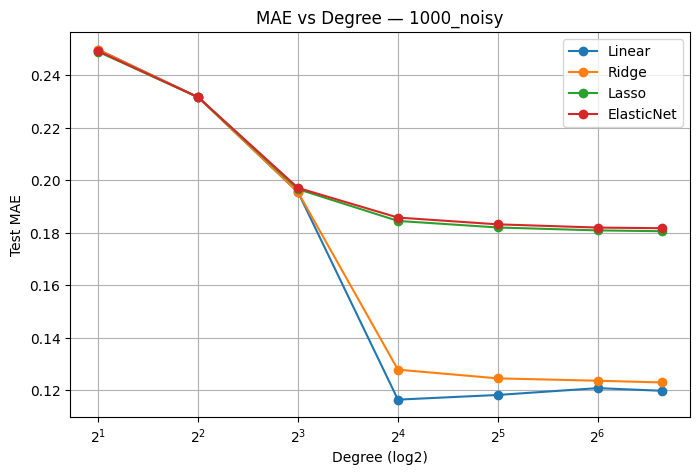

c:\Users\MOSALAS\AppData\Local\Programs\Python\Python314\Lib\site-packages\sklearn\linear_model\_coordinate_descent.py:695: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.829e+01, tolerance: 7.739e-03
  model = cd_fast.enet_coordinate_descent(
c:\Users\MOSALAS\AppData\Local\Programs\Python\Python314\Lib\site-packages\sklearn\linear_model\_coordinate_descent.py:695: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.662e+01, tolerance: 7.739e-03
  model = cd_fast.enet_coordinate_descent(
c:\Users\MOSALAS\AppData\Local\Programs\Python\Python314\Lib\site-packages\sklearn\linear_model\_coordinate_descent.py:695: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check t

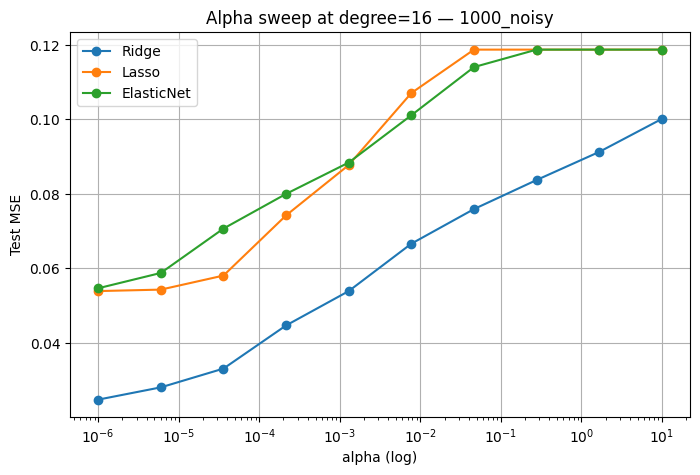

Summary (best per model): 1000_noisy
Linear: best degree=16, MSE=2.125764e-02, MAE=1.165214e-01
Ridge: best degree=100, alpha=1e-06, MSE=2.291540e-02, MAE=1.230577e-01
Lasso: best degree=100, alpha=1e-06, MSE=5.204853e-02, MAE=1.806663e-01
ElasticNet: best degree=100, alpha=1e-06, MSE=5.269654e-02, MAE=1.818059e-01
Breakpoint (heuristic) for Linear: 32
Breakpoint (heuristic) for Ridge: 100
Breakpoint (heuristic) for Lasso: 64
Breakpoint (heuristic) for ElasticNet: 64


In [54]:

datasets = {
    "100_noiseless": (x_100, y_100),
    "100_noisy": (x_100, y100noisy),
    "300_noiseless": (x_300, y_300),
    "300_noisy": (x_300, y300noisy),
    "1000_noiseless": (x_1000, y_1000),
    "1000_noisy": (x_1000, y1000noisy),
}

degrees = [2,4,8,16,32,64,100]
alphas = np.logspace(-6, 1, 10)
models_info = {
    "Ridge": Ridge,
    "Lasso": Lasso,
    "ElasticNet": ElasticNet
}

def fit_model(model_cls, degree, alpha, x_train, x_test, y_train, y_test, **kwargs):
    model = make_pipeline(PolynomialFeatures(degree), model_cls(alpha=alpha, **kwargs))
    model.fit(x_train.reshape(-1,1), y_train)
    y_pred = model.predict(x_test.reshape(-1,1))
    return mean_squared_error(y_test, y_pred), mean_absolute_error(y_test, y_pred)

def analyze_dataset(key, x, y):
    # train/test split
    Xt, Xs, yt, ys = train_test_split(x, y, test_size=0.3, random_state=42, shuffle=True)
    Xt_s = Xt / np.max(np.abs(x)); Xs_s = Xs / np.max(np.abs(x))
    # store results
    results = {"Linear":{}, "Ridge":{}, "Lasso":{}, "ElasticNet":{}}
    # linear (no reg) baseline (we use LinearRegression via Ridge(alpha=0) for simplicity)
    for d in degrees:
        model = make_pipeline(PolynomialFeatures(d), LinearRegression())
        model.fit(Xt_s.reshape(-1,1), yt)
        ypred = model.predict(Xs_s.reshape(-1,1))
        results["Linear"][d] = {
            "mse": mean_squared_error(ys, ypred),
            "mae": mean_absolute_error(ys, ypred)
        }
    # regularized models: pick best alpha per degree
    for name, cls in models_info.items():
        for d in degrees:
            best = {"mse":np.inf,"mae":np.inf,"alpha":None}
            for a in alphas:
                kwargs = {"max_iter":10000} if name!="Ridge" else {}
                if name=="ElasticNet": kwargs["l1_ratio"]=0.5
                try:
                    mse, mae = fit_model(cls, d, a, Xt_s, Xs_s, yt, ys, **kwargs)
                except Exception:
                    mse, mae = np.nan, np.nan
                if mse < best["mse"]:
                    best.update({"mse":mse, "mae":mae, "alpha":a})
            results[name][d] = best
    # plotting: MSE vs degree
    plt.figure(figsize=(8,5))
    for name in ["Linear","Ridge","Lasso","ElasticNet"]:
        mses = [results[name][d]["mse"] for d in degrees]
        plt.plot(degrees, mses, marker='o', label=name)
    plt.xscale('log', base=2); plt.xlabel('Degree (log2)'); plt.ylabel('Test MSE')
    plt.title(f'MSE vs Degree — {key}'); plt.legend(); plt.grid(True); plt.show()
    # MAE vs degree
    plt.figure(figsize=(8,5))
    for name in ["Linear","Ridge","Lasso","ElasticNet"]:
        maes = [results[name][d]["mae"] for d in degrees]
        plt.plot(degrees, maes, marker='o', label=name)
    plt.xscale('log', base=2); plt.xlabel('Degree (log2)'); plt.ylabel('Test MAE')
    plt.title(f'MAE vs Degree — {key}'); plt.legend(); plt.grid(True); plt.show()
    # alpha-sweep for a mid degree (pick 16 or nearest)
    mid_deg = 16
    plt.figure(figsize=(8,5))
    for name, cls in models_info.items():
        arr = []
        for a in alphas:
            kwargs = {"max_iter":10000} if name!="Ridge" else {}
            if name=="ElasticNet": kwargs["l1_ratio"]=0.5
            try:
                mse, _ = fit_model(cls, mid_deg, a, Xt_s, Xs_s, yt, ys, **kwargs)
            except Exception:
                mse = np.nan
            arr.append(mse)
        plt.plot(alphas, arr, marker='o', label=name)
    plt.xscale('log'); plt.xlabel('alpha (log)'); plt.ylabel('Test MSE')
    plt.title(f'Alpha sweep at degree={mid_deg} — {key}'); plt.legend(); plt.grid(True); plt.show()
    # print best overall per model
    print("Summary (best per model):", key)
    for name in ["Linear","Ridge","Lasso","ElasticNet"]:
        bestd = min(degrees, key=lambda d: results[name][d]["mse"])
        entry = results[name][bestd]
        if name=="Linear":
            print(f"{name}: best degree={bestd}, MSE={entry['mse']:.6e}, MAE={entry['mae']:.6e}")
        else:
            print(f"{name}: best degree={bestd}, alpha={entry['alpha']}, MSE={entry['mse']:.6e}, MAE={entry['mae']:.6e}")
    # tentative breakpoint detection (1% improvement threshold)
    threshold = 0.01
    for name in ["Linear","Ridge","Lasso","ElasticNet"]:
        prev = np.inf; bp=None
        for d in degrees:
            mse = results[name][d]["mse"]
            if prev==np.inf: prev=mse; continue
            rel = (prev - mse)/prev if prev!=0 else 0
            if rel < threshold:
                bp=d; break
            prev=mse
        print(f"Breakpoint (heuristic) for {name}: {bp}")
    return results

# run for all datasets
all_results = {}
for key, (x,y) in datasets.items():
    print("\n--- Analyzing", key)
    all_results[key] = analyze_dataset(key, x, y)

part 6

Adding outliers to 100_noiseless
Adding outliers to 100_noisy
Adding outliers to 300_noiseless
Adding outliers to 300_noisy
Adding outliers to 1000_noiseless
Adding outliers to 1000_noisy


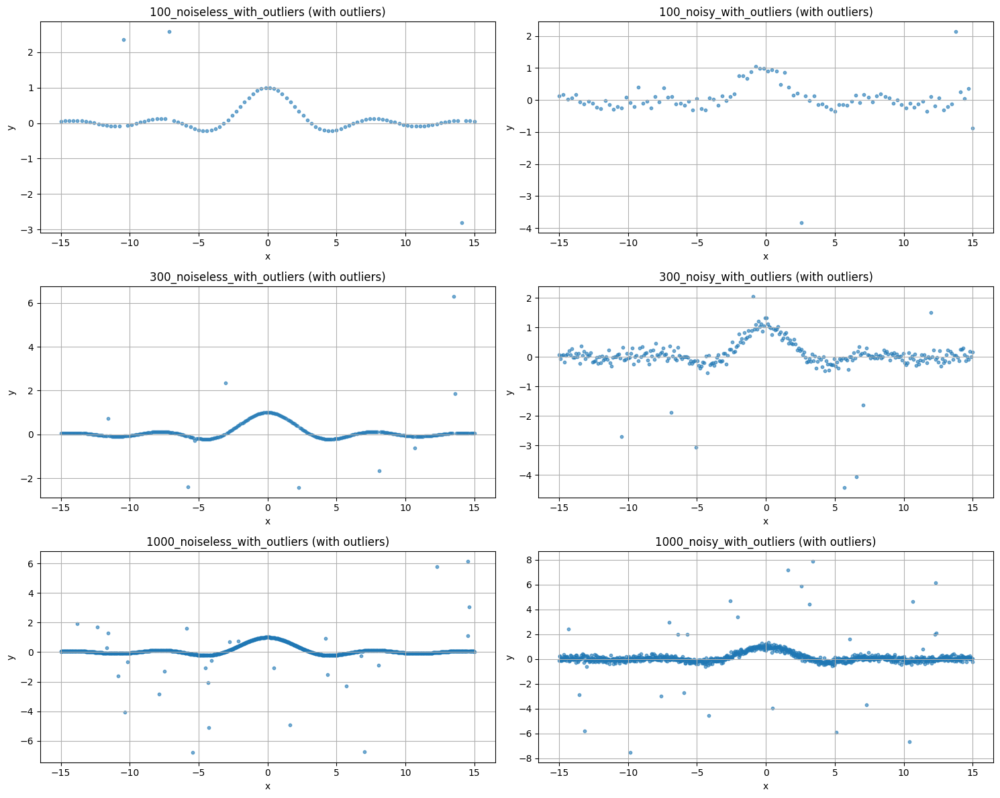

In [57]:
def add_outliers(x, y, percentage=0.03, multiplier=5):
    n = len(x)
    k = max(1, int(n * percentage))

    # انتخاب تصادفی نقاط
    idx = np.random.choice(n, k, replace=False)

    # ایجاد پرت‌های شدید (در y)
    y_out = y.copy().astype(float)
    y_out[idx] += multiplier * np.std(y) * np.random.randn(k)

    return x, y_out

# ساخت نسخه‌های جدید دیتاست‌ها با داده‌ پرت
datasets_outliers = {}

for key, (x, y) in datasets.items():
    print("Adding outliers to", key)
    x_new, y_new = add_outliers(x, y, 0.03, 10)
    datasets_outliers[key + "_with_outliers"] = (x_new, y_new)

datasets_outliers


plt.figure(figsize=(15, 12))

i = 1
for key, (x, y) in datasets_outliers.items():
    plt.subplot(3, 2, i)
    plt.scatter(x, y, s=10, alpha=0.6)
    plt.title(f"{key} (with outliers)")
    plt.xlabel("x")
    plt.ylabel("y")
    plt.grid(True)
    i += 1

plt.tight_layout()
plt.show()

3% of the data turned to outlier


=== Dataset: 100_noiseless  (n= 100 ) ===


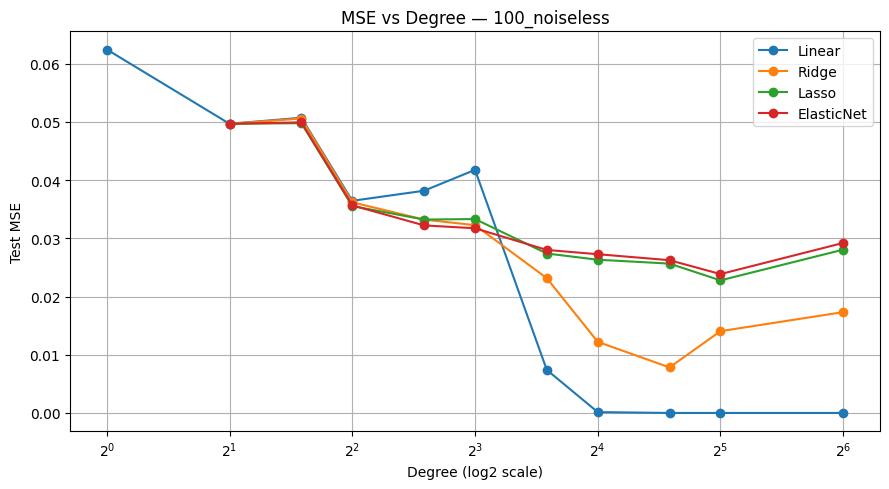

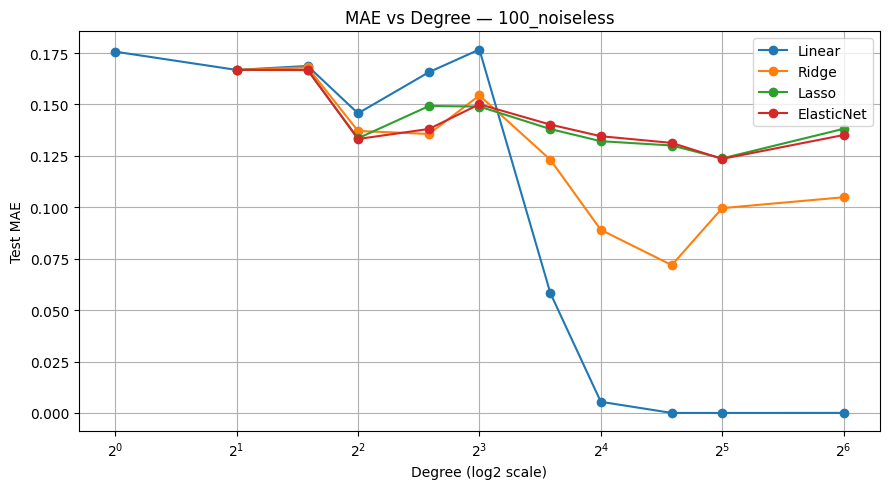

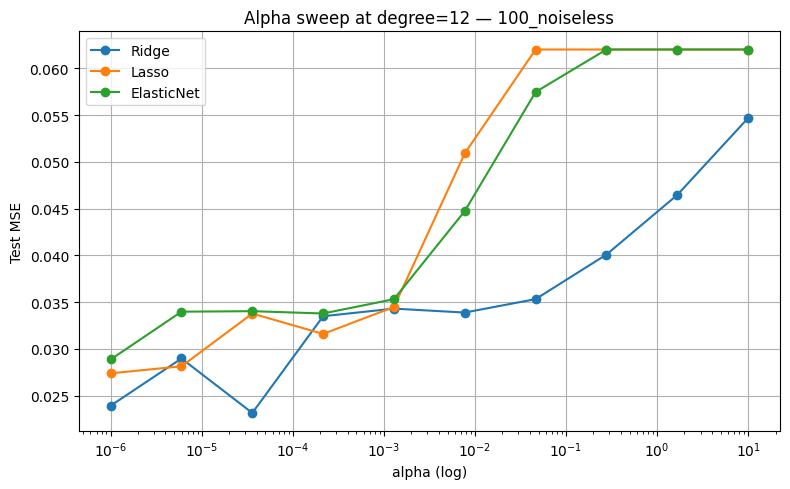

Best per model (degree, alpha, MSE, MAE):
  Linear: degree=32, MSE=1.621859e-17, MAE=7.472904e-10
  Ridge: degree=24, alpha=1e-06, MSE=7.823997e-03, MAE=7.187692e-02
  Lasso: degree=32, alpha=5.994842503189409e-06, MSE=2.278077e-02, MAE=1.237653e-01
  ElasticNet: degree=32, alpha=5.994842503189409e-06, l1_ratio=0.8, MSE=2.386171e-02, MAE=1.235401e-01
  Breakpoint (heuristic) for Linear: 3
  Breakpoint (heuristic) for Ridge: 3
  Breakpoint (heuristic) for Lasso: 3
  Breakpoint (heuristic) for ElasticNet: 3

=== Dataset: 100_noisy  (n= 100 ) ===


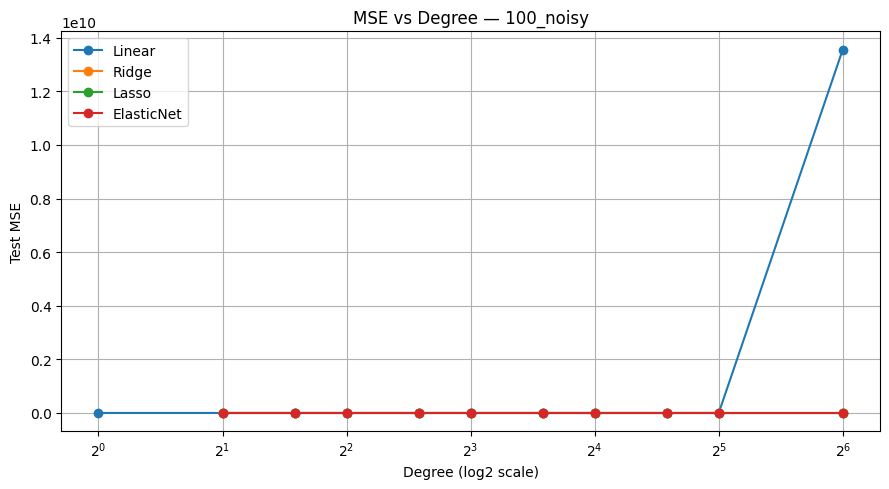

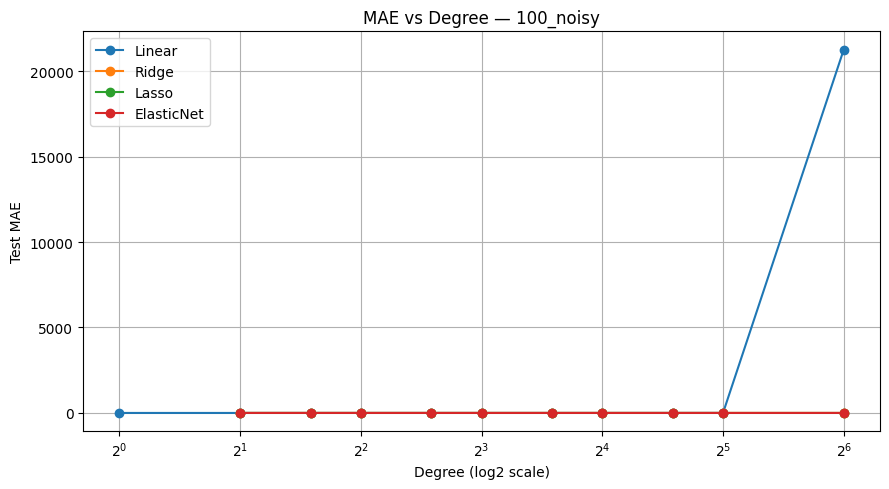

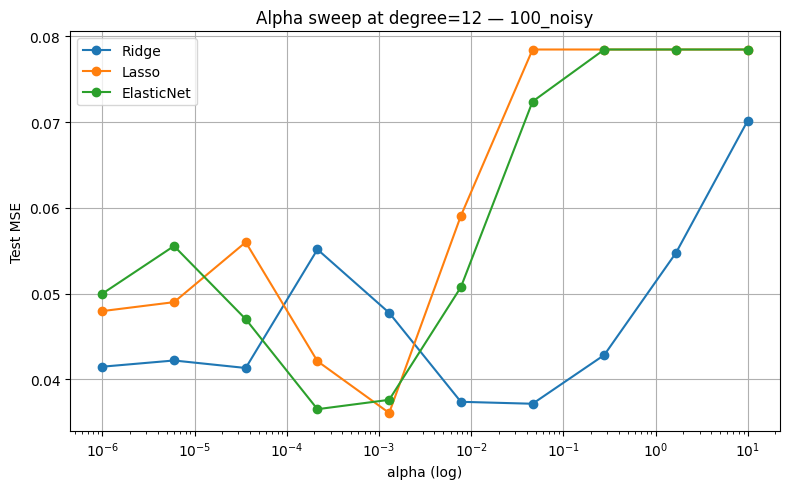

Best per model (degree, alpha, MSE, MAE):
  Linear: degree=16, MSE=3.087759e-02, MAE=1.427419e-01
  Ridge: degree=4, alpha=1e-06, MSE=3.477877e-02, MAE=1.610058e-01
  Lasso: degree=4, alpha=1e-06, MSE=3.477878e-02, MAE=1.610080e-01
  ElasticNet: degree=4, alpha=1e-06, l1_ratio=0.8, MSE=3.477925e-02, MAE=1.610092e-01
  Breakpoint (heuristic) for Linear: 3
  Breakpoint (heuristic) for Ridge: 3
  Breakpoint (heuristic) for Lasso: 3
  Breakpoint (heuristic) for ElasticNet: 3

=== Dataset: 300_noiseless  (n= 300 ) ===


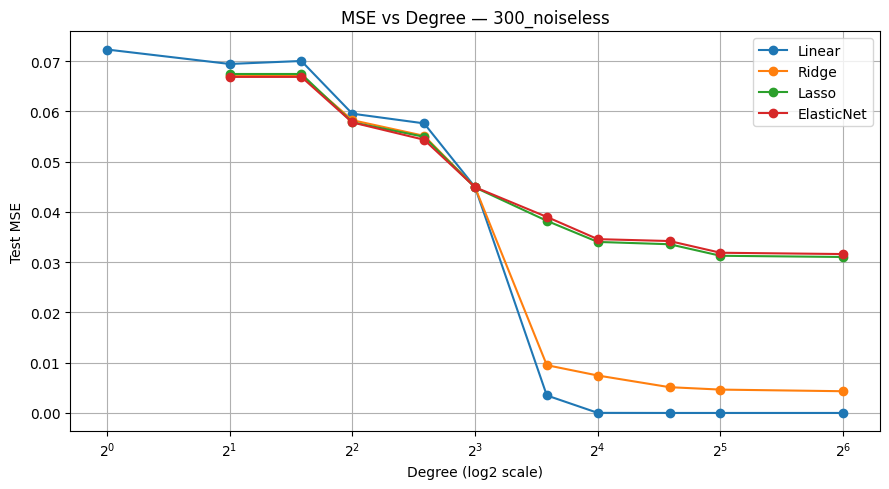

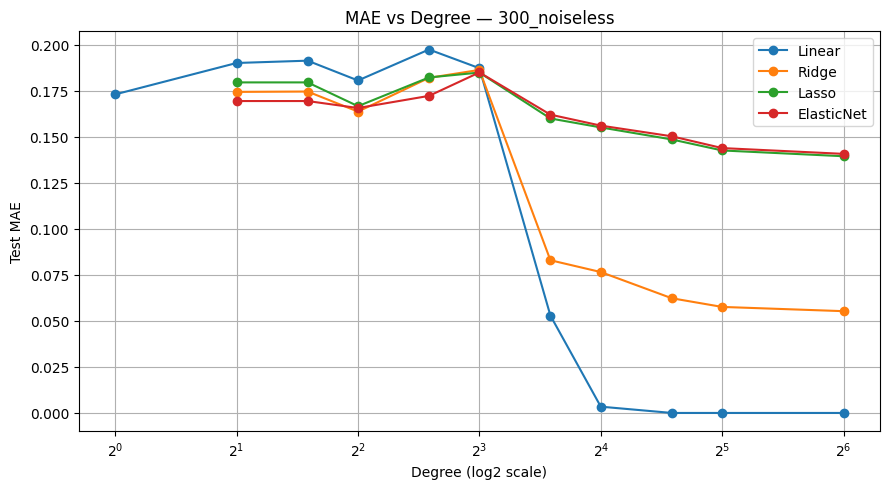

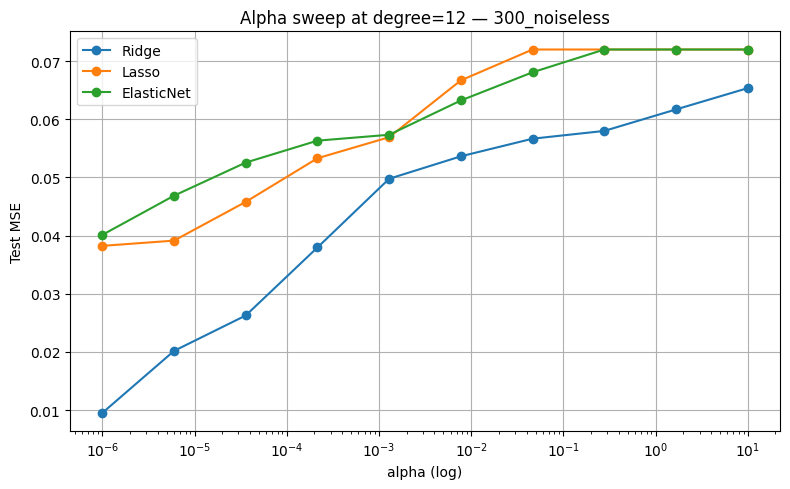

Best per model (degree, alpha, MSE, MAE):
  Linear: degree=32, MSE=3.552351e-22, MAE=1.590189e-11
  Ridge: degree=64, alpha=1e-06, MSE=4.323076e-03, MAE=5.525452e-02
  Lasso: degree=64, alpha=1e-06, MSE=3.104456e-02, MAE=1.393647e-01
  ElasticNet: degree=64, alpha=1e-06, l1_ratio=0.8, MSE=3.162570e-02, MAE=1.406450e-01
  Breakpoint (heuristic) for Linear: 3
  Breakpoint (heuristic) for Ridge: 3
  Breakpoint (heuristic) for Lasso: 3
  Breakpoint (heuristic) for ElasticNet: 3

=== Dataset: 300_noisy  (n= 300 ) ===


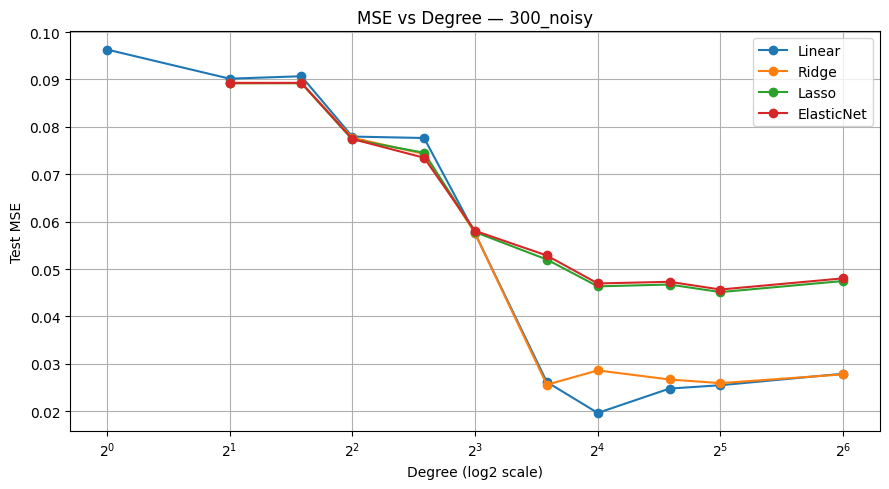

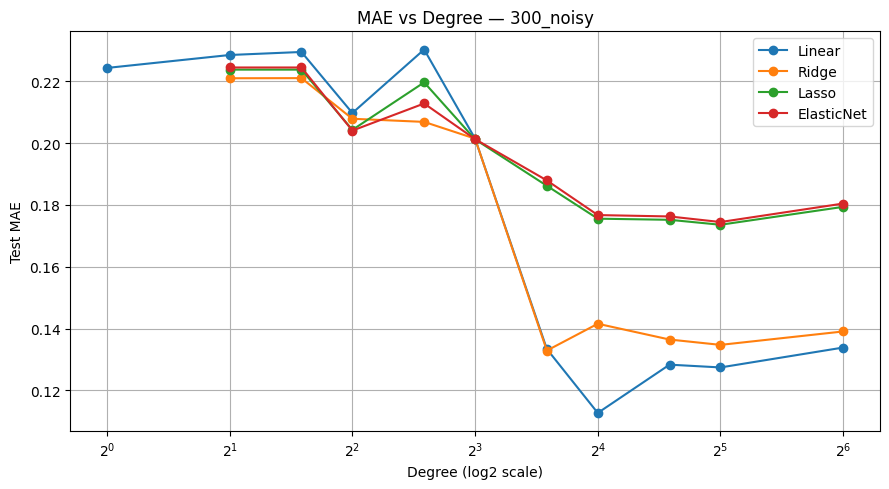

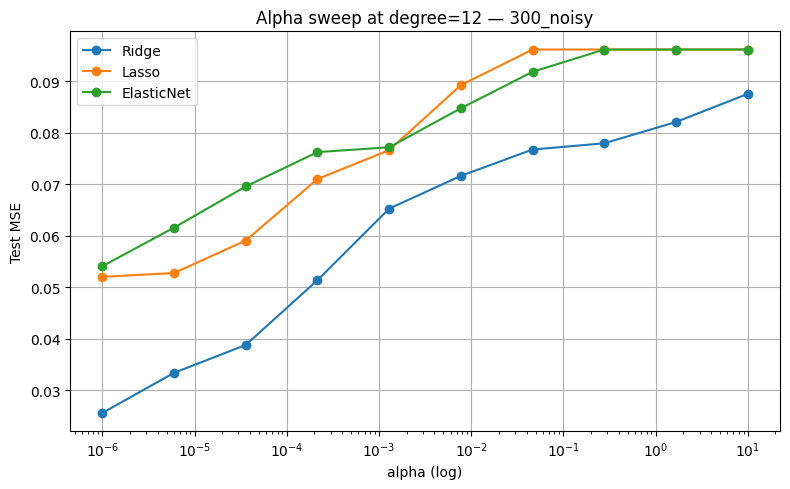

Best per model (degree, alpha, MSE, MAE):
  Linear: degree=16, MSE=1.962325e-02, MAE=1.127294e-01
  Ridge: degree=12, alpha=1e-06, MSE=2.558139e-02, MAE=1.329014e-01
  Lasso: degree=32, alpha=1e-06, MSE=4.512731e-02, MAE=1.735916e-01
  ElasticNet: degree=32, alpha=1e-06, l1_ratio=0.8, MSE=4.567241e-02, MAE=1.744726e-01
  Breakpoint (heuristic) for Linear: 3
  Breakpoint (heuristic) for Ridge: 3
  Breakpoint (heuristic) for Lasso: 3
  Breakpoint (heuristic) for ElasticNet: 3

=== Dataset: 1000_noiseless  (n= 1000 ) ===


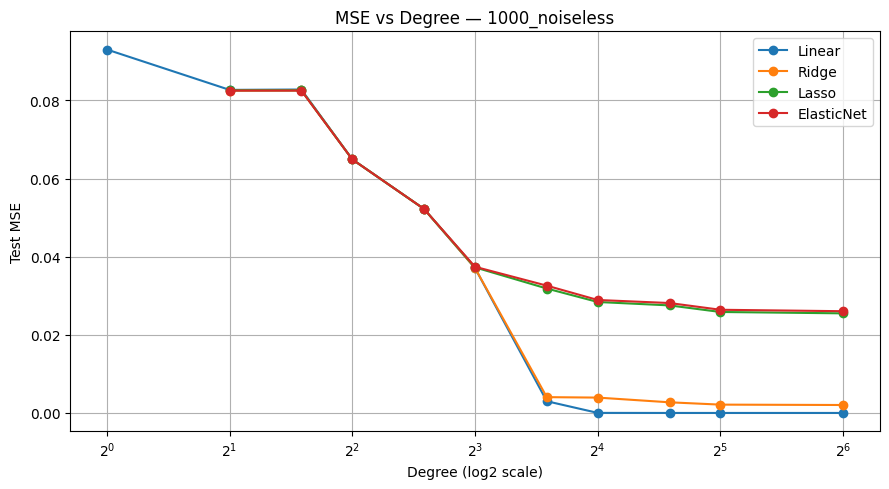

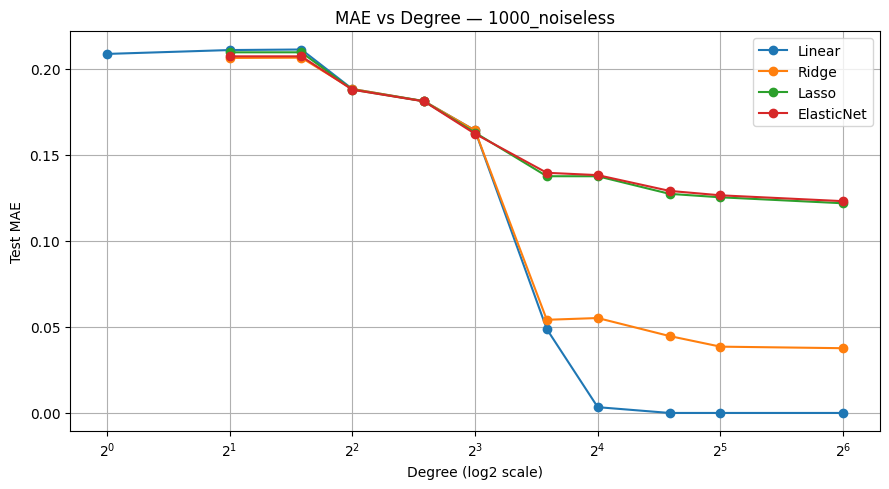

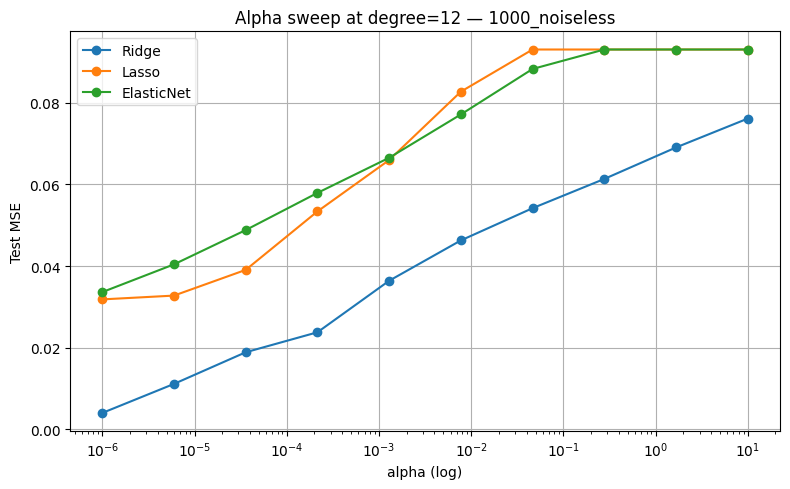

Best per model (degree, alpha, MSE, MAE):
  Linear: degree=32, MSE=2.871667e-22, MAE=1.470815e-11
  Ridge: degree=64, alpha=1e-06, MSE=2.034455e-03, MAE=3.763989e-02
  Lasso: degree=64, alpha=1e-06, MSE=2.549428e-02, MAE=1.219015e-01
  ElasticNet: degree=64, alpha=1e-06, l1_ratio=0.8, MSE=2.604102e-02, MAE=1.231297e-01
  Breakpoint (heuristic) for Linear: 3
  Breakpoint (heuristic) for Ridge: 3
  Breakpoint (heuristic) for Lasso: 3
  Breakpoint (heuristic) for ElasticNet: 3

=== Dataset: 1000_noisy  (n= 1000 ) ===


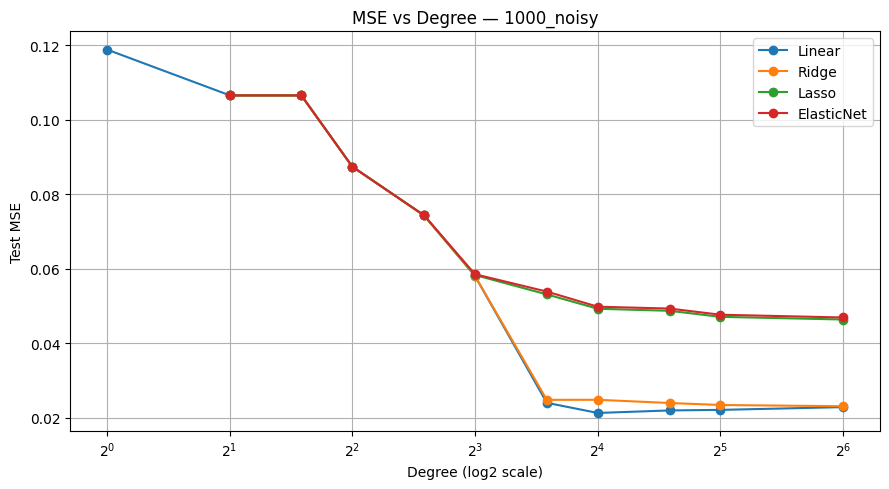

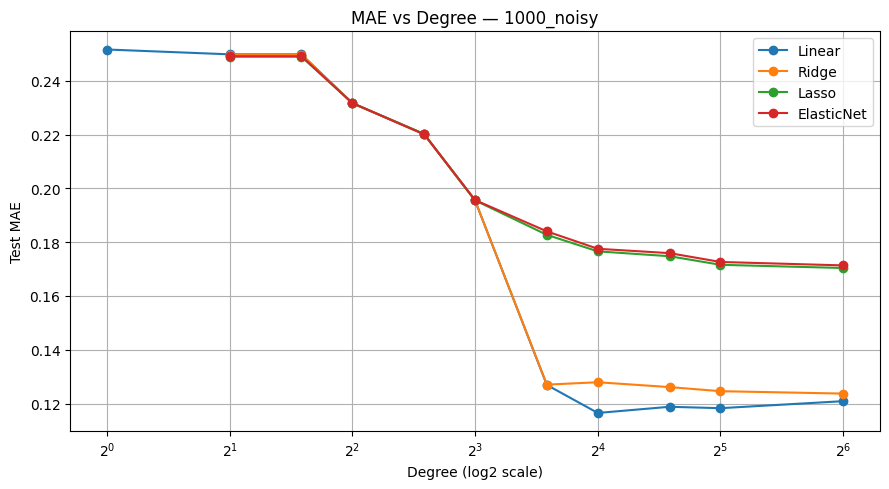

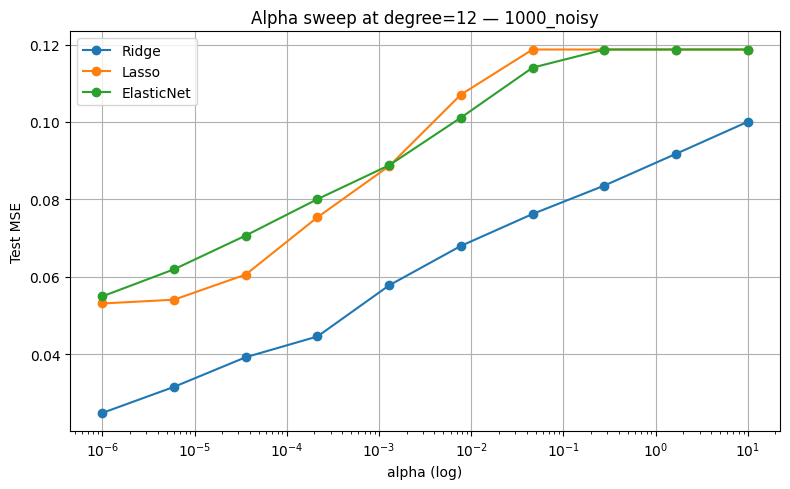

Best per model (degree, alpha, MSE, MAE):
  Linear: degree=16, MSE=2.125764e-02, MAE=1.165214e-01
  Ridge: degree=64, alpha=1e-06, MSE=2.306246e-02, MAE=1.237160e-01
  Lasso: degree=64, alpha=1e-06, MSE=4.633139e-02, MAE=1.704058e-01
  ElasticNet: degree=64, alpha=1e-06, l1_ratio=0.8, MSE=4.687585e-02, MAE=1.713738e-01
  Breakpoint (heuristic) for Linear: 3
  Breakpoint (heuristic) for Ridge: 3
  Breakpoint (heuristic) for Lasso: 3
  Breakpoint (heuristic) for ElasticNet: 3

=== Dataset: 100_noiseless_with_outliers  (n= 100 ) ===


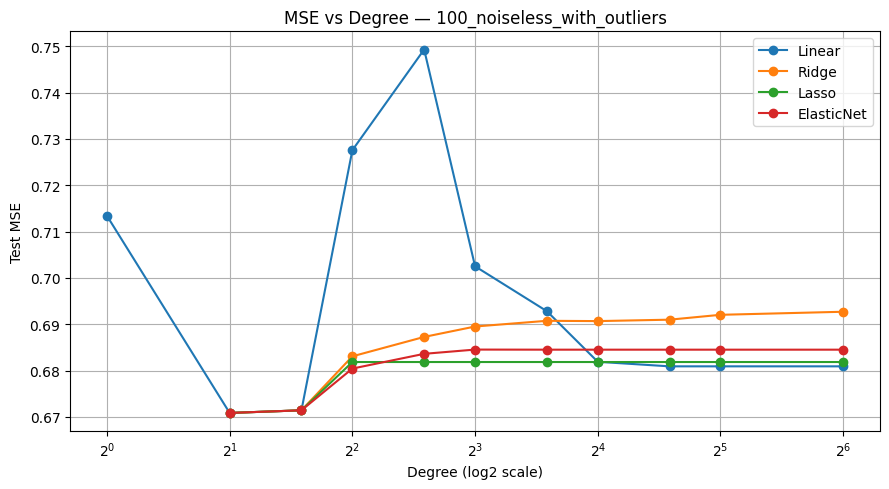

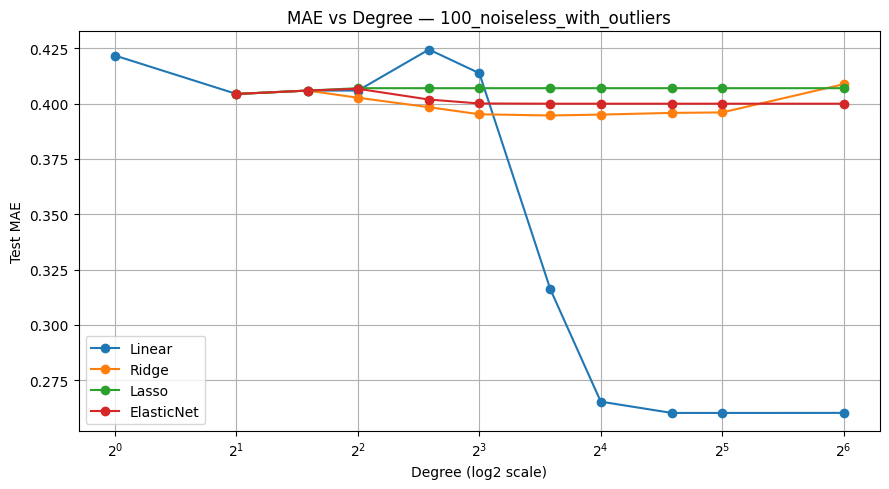

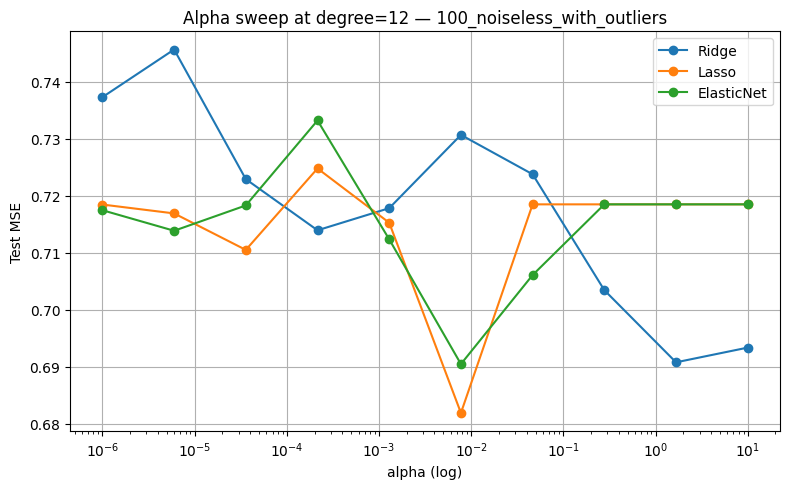

Best per model (degree, alpha, MSE, MAE):
  Linear: degree=2, MSE=6.708610e-01, MAE=4.043353e-01
  Ridge: degree=2, alpha=1e-06, MSE=6.708610e-01, MAE=4.043353e-01
  Lasso: degree=2, alpha=1e-06, MSE=6.708630e-01, MAE=4.043359e-01
  ElasticNet: degree=2, alpha=1e-06, l1_ratio=0.2, MSE=6.708616e-01, MAE=4.043355e-01
  Breakpoint (heuristic) for Linear: 3
  Breakpoint (heuristic) for Ridge: 3
  Breakpoint (heuristic) for Lasso: 3
  Breakpoint (heuristic) for ElasticNet: 3

=== Dataset: 100_noisy_with_outliers  (n= 100 ) ===


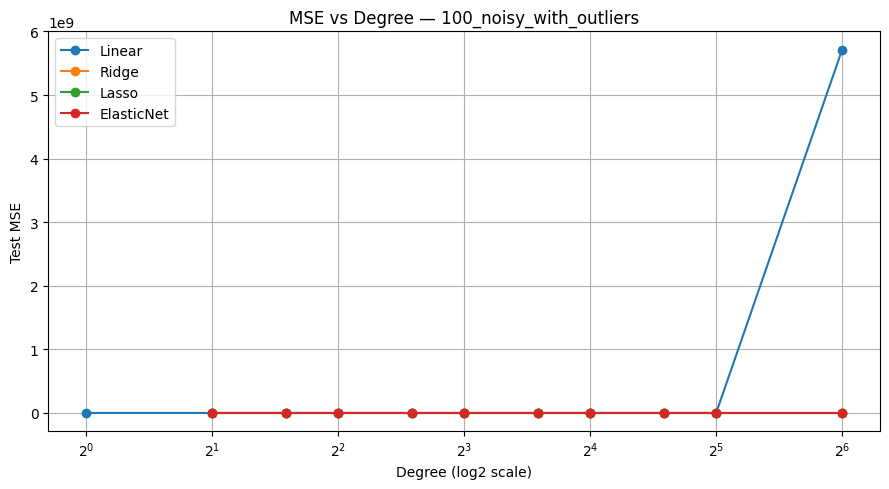

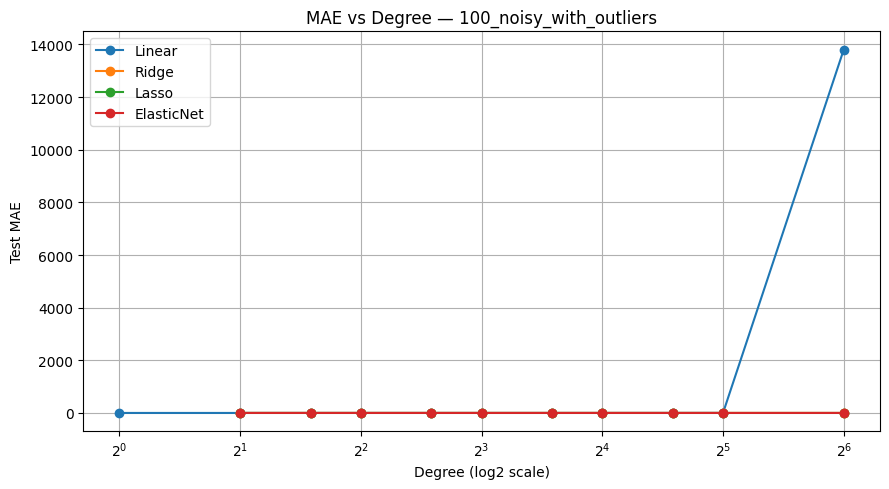

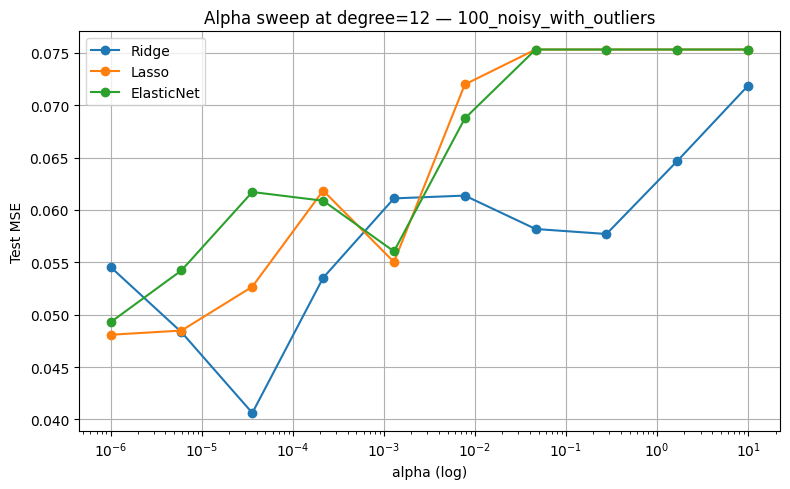

Best per model (degree, alpha, MSE, MAE):
  Linear: degree=12, MSE=3.554898e-02, MAE=1.481874e-01
  Ridge: degree=12, alpha=3.5938136638046256e-05, MSE=4.062431e-02, MAE=1.758919e-01
  Lasso: degree=16, alpha=3.5938136638046256e-05, MSE=4.450529e-02, MAE=1.861229e-01
  ElasticNet: degree=16, alpha=5.994842503189409e-06, l1_ratio=0.8, MSE=4.548135e-02, MAE=1.861151e-01
  Breakpoint (heuristic) for Linear: 3
  Breakpoint (heuristic) for Ridge: 3
  Breakpoint (heuristic) for Lasso: 3
  Breakpoint (heuristic) for ElasticNet: 3

=== Dataset: 300_noiseless_with_outliers  (n= 300 ) ===


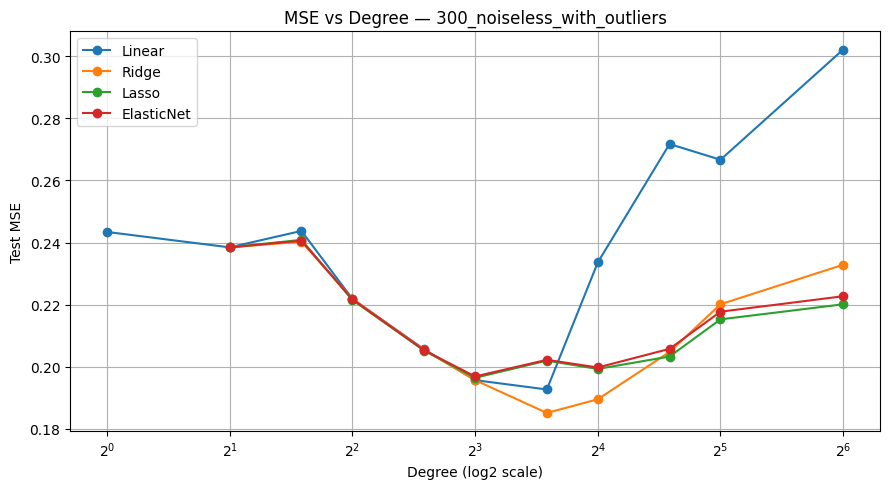

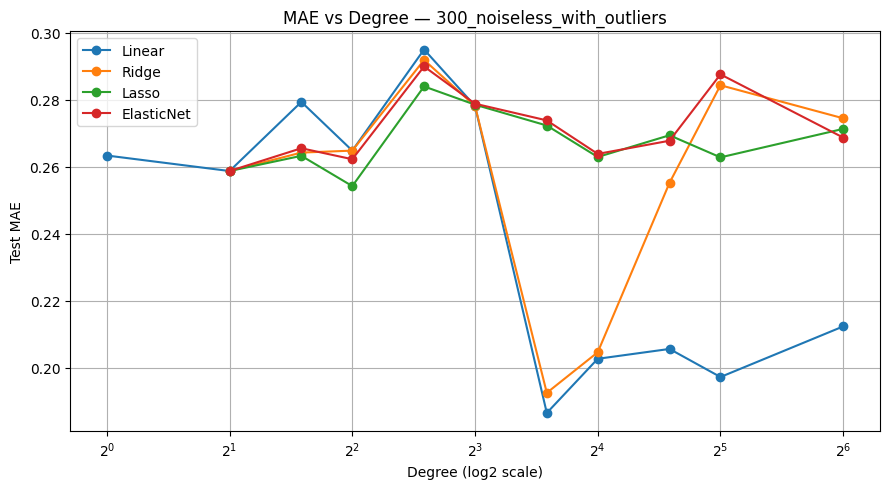

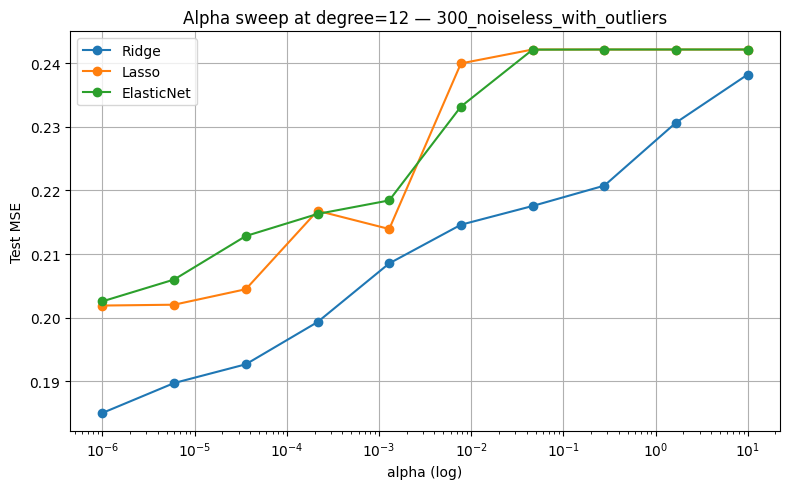

Best per model (degree, alpha, MSE, MAE):
  Linear: degree=12, MSE=1.926202e-01, MAE=1.865830e-01
  Ridge: degree=12, alpha=1e-06, MSE=1.850482e-01, MAE=1.925787e-01
  Lasso: degree=8, alpha=1e-06, MSE=1.963694e-01, MAE=2.785277e-01
  ElasticNet: degree=8, alpha=1e-06, l1_ratio=0.8, MSE=1.968107e-01, MAE=2.788168e-01
  Breakpoint (heuristic) for Linear: 3
  Breakpoint (heuristic) for Ridge: 3
  Breakpoint (heuristic) for Lasso: 3
  Breakpoint (heuristic) for ElasticNet: 3

=== Dataset: 300_noisy_with_outliers  (n= 300 ) ===


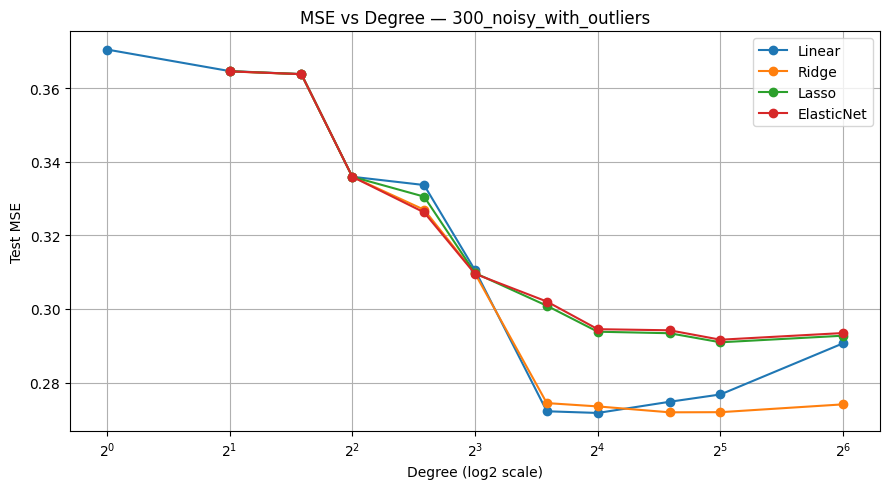

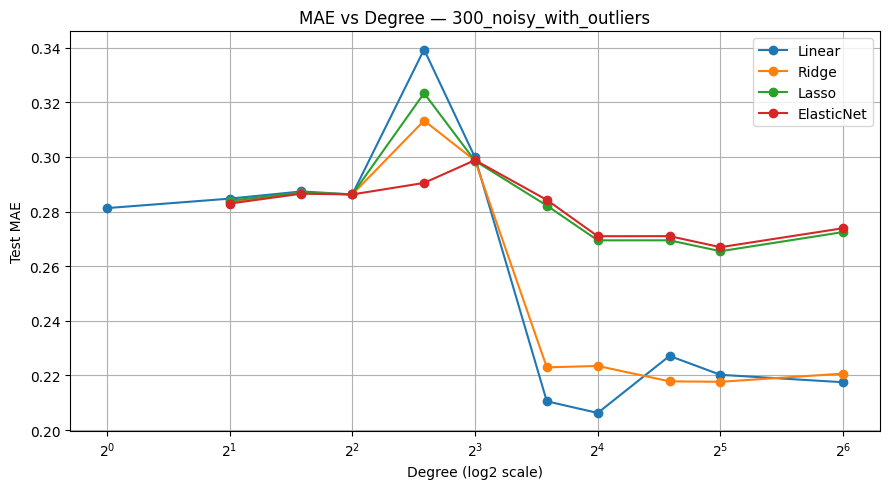

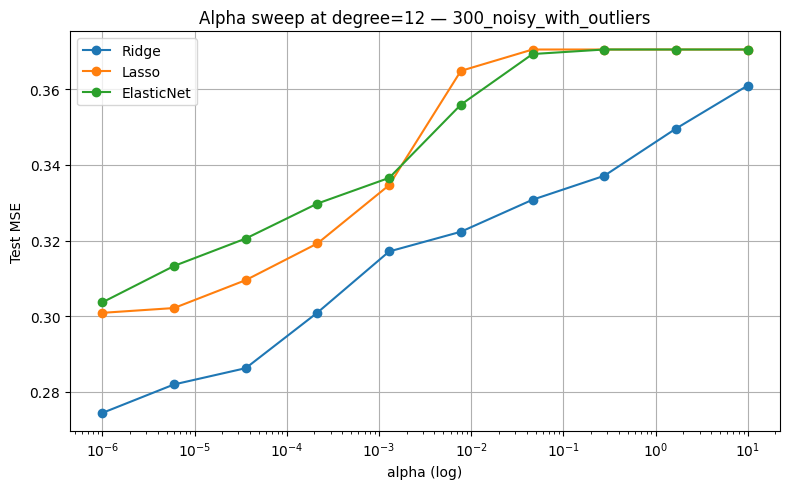

Best per model (degree, alpha, MSE, MAE):
  Linear: degree=16, MSE=2.717540e-01, MAE=2.062893e-01
  Ridge: degree=24, alpha=1e-06, MSE=2.719278e-01, MAE=2.178543e-01
  Lasso: degree=32, alpha=1e-06, MSE=2.909523e-01, MAE=2.654728e-01
  ElasticNet: degree=32, alpha=1e-06, l1_ratio=0.8, MSE=2.916534e-01, MAE=2.669488e-01
  Breakpoint (heuristic) for Linear: 3
  Breakpoint (heuristic) for Ridge: 3
  Breakpoint (heuristic) for Lasso: 3
  Breakpoint (heuristic) for ElasticNet: 3

=== Dataset: 1000_noiseless_with_outliers  (n= 1000 ) ===


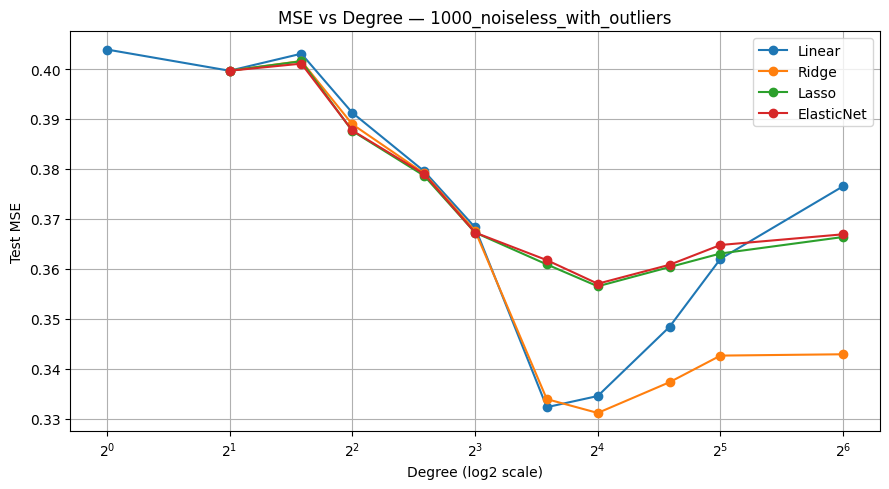

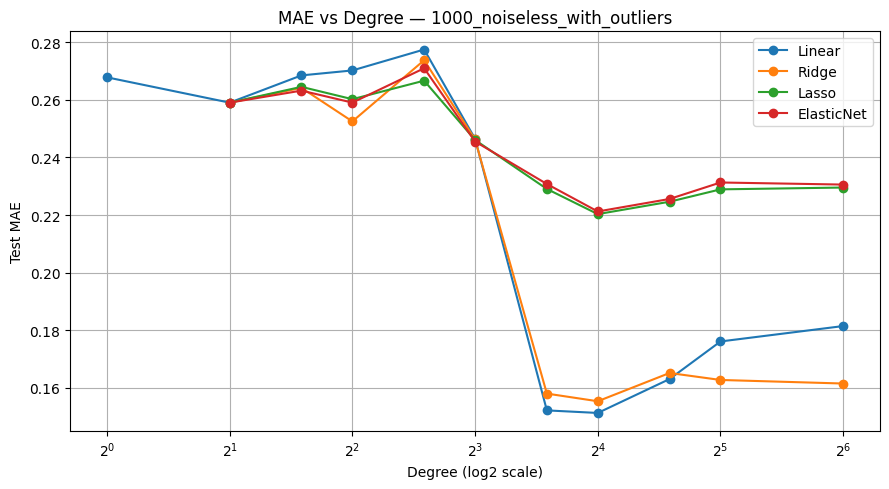

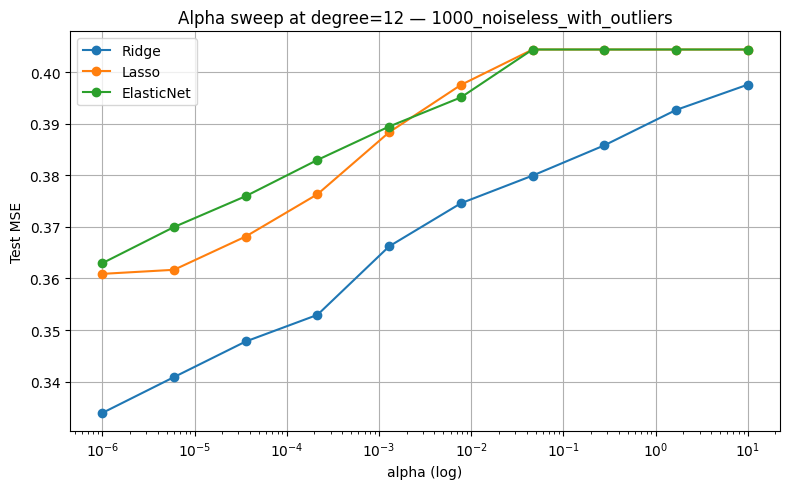

Best per model (degree, alpha, MSE, MAE):
  Linear: degree=12, MSE=3.323170e-01, MAE=1.521386e-01
  Ridge: degree=16, alpha=1e-06, MSE=3.311625e-01, MAE=1.553125e-01
  Lasso: degree=16, alpha=1e-06, MSE=3.565125e-01, MAE=2.203209e-01
  ElasticNet: degree=16, alpha=1e-06, l1_ratio=0.8, MSE=3.570273e-01, MAE=2.212358e-01
  Breakpoint (heuristic) for Linear: 3
  Breakpoint (heuristic) for Ridge: 3
  Breakpoint (heuristic) for Lasso: 3
  Breakpoint (heuristic) for ElasticNet: 3

=== Dataset: 1000_noisy_with_outliers  (n= 1000 ) ===


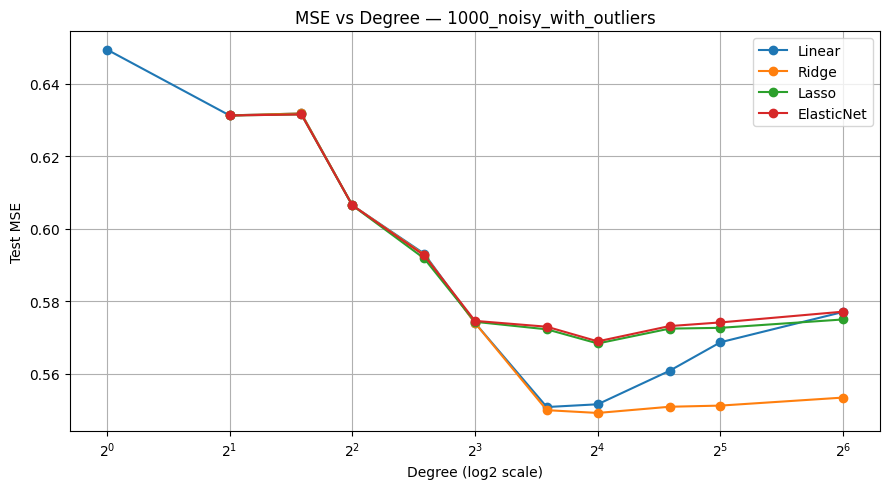

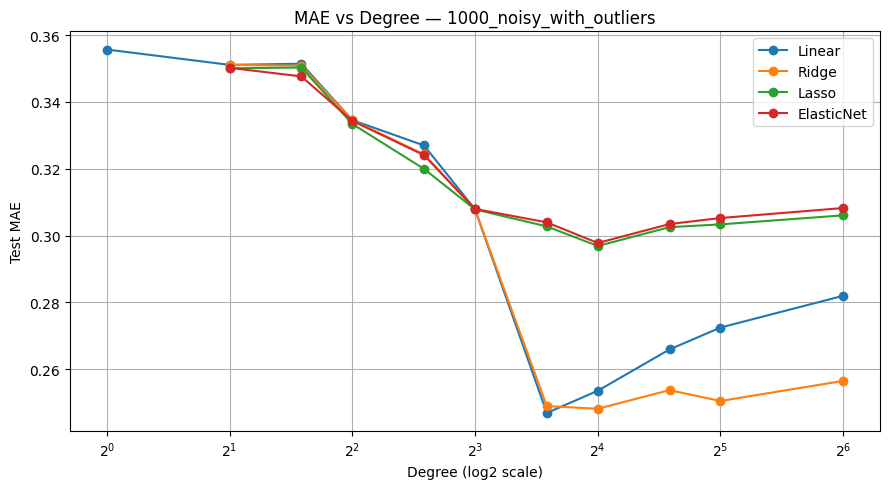

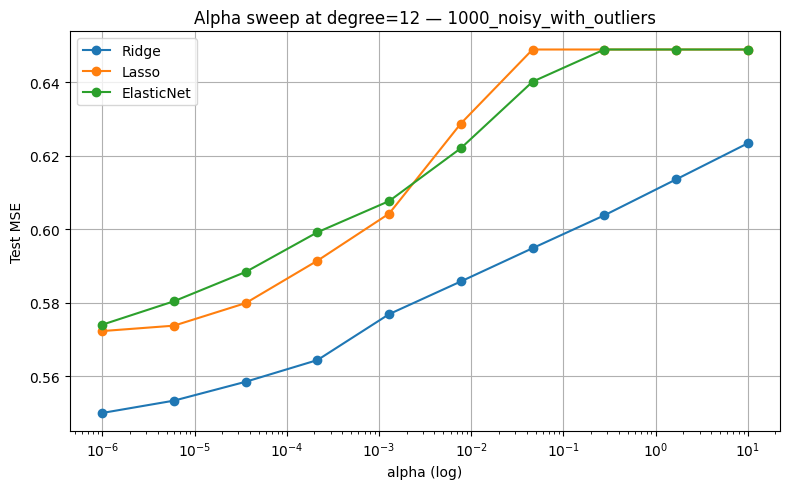

Best per model (degree, alpha, MSE, MAE):
  Linear: degree=12, MSE=5.508719e-01, MAE=2.469372e-01
  Ridge: degree=16, alpha=1e-06, MSE=5.492412e-01, MAE=2.481920e-01
  Lasso: degree=16, alpha=1e-06, MSE=5.683844e-01, MAE=2.968988e-01
  ElasticNet: degree=16, alpha=1e-06, l1_ratio=0.8, MSE=5.689652e-01, MAE=2.977975e-01
  Breakpoint (heuristic) for Linear: 3
  Breakpoint (heuristic) for Ridge: 3
  Breakpoint (heuristic) for Lasso: 3
  Breakpoint (heuristic) for ElasticNet: 3

DONE: summaries stored in summary_all dictionary (inspect for details).


In [59]:
# --- warnings / reproducibility ---
warnings.filterwarnings("ignore", category=ConvergenceWarning)
np.random.seed(42)

datasets = {
    "100_noiseless": (x_100, y_100),
    "100_noisy": (x_100, y100noisy),
    "300_noiseless": (x_300, y_300),
    "300_noisy": (x_300, y300noisy),
    "1000_noiseless": (x_1000, y_1000),
    "1000_noisy": (x_1000, y1000noisy),
}

all_datasets = {}
all_datasets.update(datasets)
all_datasets.update(datasets_outliers)

degrees = [2, 3, 4, 6, 8, 12, 16, 24, 32, 64]   # 10 degrees
alphas = np.logspace(-6, 1, 10)  # regularization strengths to test
elastic_l1_ratios = [0.2, 0.5, 0.8]  # for ElasticNet search (kept small to limit runtime)

# models to test
models_info = {
    "Linear": None,    # handled separately (no regularization)
    "Ridge": Ridge,
    "Lasso": Lasso,
    "ElasticNet": ElasticNet
}

# increase iterations for Lasso/ElasticNet to reduce convergence warnings
reg_kwargs = {"max_iter": 20000}

# --- fitting helper ---
def fit_and_eval_pipeline(model_obj, X_train, X_test, y_train, y_test):
    model_obj.fit(X_train.reshape(-1,1), y_train)
    y_pred = model_obj.predict(X_test.reshape(-1,1))
    return mean_squared_error(y_test, y_pred), mean_absolute_error(y_test, y_pred), y_pred

# --- main loop over datasets ---
summary_all = {}

for ds_name, (x, y) in all_datasets.items():
    print("\n=== Dataset:", ds_name, " (n=", len(x), ") ===")
    # train/test split (keep random_state fixed for reproducibility)
    X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=42, shuffle=True)
    # scale x into [-1,1] by dividing by max abs(x) for numerical stability of polynomial features
    scale = np.max(np.abs(x))
    X_train_s = X_train / scale
    X_test_s = X_test / scale

    results = {"Linear": {}, "Ridge": {}, "Lasso": {}, "ElasticNet": {}}

    # 1) Linear regression baseline (polynomial degree=1)
    lin_model = make_pipeline(PolynomialFeatures(1), LinearRegression())
    mse_lin, mae_lin, _ = fit_and_eval_pipeline(lin_model, X_train_s, X_test_s, y_train, y_test)
    results["Linear"][1] = {"mse": mse_lin, "mae": mae_lin, "degree": 1}

    # 2) Polynomial & regularized sweeps
    for d in degrees:
        # baseline polynomial (no reg) for this degree
        poly = make_pipeline(PolynomialFeatures(d), LinearRegression())
        try:
            mse_p, mae_p, _ = fit_and_eval_pipeline(poly, X_train_s, X_test_s, y_train, y_test)
        except Exception:
            mse_p, mae_p = np.nan, np.nan
        results["Linear"][d] = {"mse": mse_p, "mae": mae_p, "degree": d}

        # Ridge: choose best alpha for this degree
        best_r = {"mse": np.inf, "mae": np.inf, "alpha": None}
        for a in alphas:
            model_r = make_pipeline(PolynomialFeatures(d), Ridge(alpha=a))
            try:
                mse_r, mae_r, _ = fit_and_eval_pipeline(model_r, X_train_s, X_test_s, y_train, y_test)
            except Exception:
                mse_r, mae_r = np.nan, np.nan
            if mse_r < best_r["mse"]:
                best_r.update({"mse": mse_r, "mae": mae_r, "alpha": a})
        results["Ridge"][d] = best_r

        # Lasso
        best_l = {"mse": np.inf, "mae": np.inf, "alpha": None}
        for a in alphas:
            try:
                model_l = make_pipeline(PolynomialFeatures(d), Lasso(alpha=a, **reg_kwargs))
                mse_l, mae_l, _ = fit_and_eval_pipeline(model_l, X_train_s, X_test_s, y_train, y_test)
            except Exception:
                mse_l, mae_l = np.nan, np.nan
            if mse_l < best_l["mse"]:
                best_l.update({"mse": mse_l, "mae": mae_l, "alpha": a})
        results["Lasso"][d] = best_l

        # ElasticNet: search over alpha and a few l1_ratios (kept small for speed)
        best_e = {"mse": np.inf, "mae": np.inf, "alpha": None, "l1_ratio": None}
        for a in alphas:
            for l1 in elastic_l1_ratios:
                try:
                    model_e = make_pipeline(PolynomialFeatures(d), ElasticNet(alpha=a, l1_ratio=l1, **reg_kwargs))
                    mse_e, mae_e, _ = fit_and_eval_pipeline(model_e, X_train_s, X_test_s, y_train, y_test)
                except Exception:
                    mse_e, mae_e = np.nan, np.nan
                if mse_e < best_e["mse"]:
                    best_e.update({"mse": mse_e, "mae": mae_e, "alpha": a, "l1_ratio": l1})
        results["ElasticNet"][d] = best_e

    # --- plotting: MSE vs degree (include Linear as degree=1 baseline) ---
    degs_plot = [1] + degrees
    plt.figure(figsize=(9,5))
    for name in ["Linear","Ridge","Lasso","ElasticNet"]:
        mses = [results[name][d]["mse"] if d in results[name] else np.nan for d in degs_plot]
        plt.plot(degs_plot, mses, marker='o', label=name)
    plt.xscale('log', base=2)
    plt.xlabel("Degree (log2 scale)"); plt.ylabel("Test MSE")
    plt.title(f"MSE vs Degree — {ds_name}")
    plt.legend(); plt.grid(True); plt.tight_layout(); plt.show()

    # plotting: MAE vs degree
    plt.figure(figsize=(9,5))
    for name in ["Linear","Ridge","Lasso","ElasticNet"]:
        maes = [results[name][d]["mae"] if d in results[name] else np.nan for d in degs_plot]
        plt.plot(degs_plot, maes, marker='o', label=name)
    plt.xscale('log', base=2)
    plt.xlabel("Degree (log2 scale)"); plt.ylabel("Test MAE")
    plt.title(f"MAE vs Degree — {ds_name}")
    plt.legend(); plt.grid(True); plt.tight_layout(); plt.show()

    # alpha-sweep at mid degree
    mid_deg = degrees[len(degrees)//2]
    plt.figure(figsize=(8,5))
    for name, cls in [("Ridge", Ridge), ("Lasso", Lasso), ("ElasticNet", ElasticNet)]:
        arr = []
        for a in alphas:
            if name == "Ridge":
                model_obj = make_pipeline(PolynomialFeatures(mid_deg), Ridge(alpha=a))
            elif name == "Lasso":
                model_obj = make_pipeline(PolynomialFeatures(mid_deg), Lasso(alpha=a, **reg_kwargs))
            else:
                model_obj = make_pipeline(PolynomialFeatures(mid_deg), ElasticNet(alpha=a, l1_ratio=0.5, **reg_kwargs))
            try:
                mse_s, mae_s, _ = fit_and_eval_pipeline(model_obj, X_train_s, X_test_s, y_train, y_test)
            except Exception:
                mse_s = np.nan
            arr.append(mse_s)
        plt.plot(alphas, arr, marker='o', label=name)
    plt.xscale('log'); plt.xlabel('alpha (log)'); plt.ylabel('Test MSE')
    plt.title(f'Alpha sweep at degree={mid_deg} — {ds_name}'); plt.legend(); plt.grid(True); plt.tight_layout(); plt.show()

    # --- summary: best per model across degrees ---
    summary = {}
    print("Best per model (degree, alpha, MSE, MAE):")
    for name in ["Linear","Ridge","Lasso","ElasticNet"]:
        # pick degree with min MSE for this model
        best_degree = min(results[name].keys(), key=lambda dd: results[name][dd]["mse"] if results[name][dd]["mse"] is not None else np.inf)
        entry = results[name][best_degree]
        if name == "Linear":
            print(f"  {name}: degree={best_degree}, MSE={entry['mse']:.6e}, MAE={entry['mae']:.6e}")
            summary[name] = {"degree": best_degree, "mse": entry['mse'], "mae": entry['mae']}
        elif name == "ElasticNet":
            print(f"  {name}: degree={best_degree}, alpha={entry['alpha']}, l1_ratio={entry['l1_ratio']}, MSE={entry['mse']:.6e}, MAE={entry['mae']:.6e}")
            summary[name] = {"degree": best_degree, "alpha": entry['alpha'], "l1_ratio": entry['l1_ratio'], "mse": entry['mse'], "mae": entry['mae']}
        else:
            print(f"  {name}: degree={best_degree}, alpha={entry['alpha']}, MSE={entry['mse']:.6e}, MAE={entry['mae']:.6e}")
            summary[name] = {"degree": best_degree, "alpha": entry['alpha'], "mse": entry['mse'], "mae": entry['mae']}

    # tentative breakpoint detection (heuristic: when improvement < 1% compared to previous degree)
    threshold = 0.01
    for name in ["Linear","Ridge","Lasso","ElasticNet"]:
        prev_mse = None
        bp = None
        for d in degs_plot:
            mse_d = results[name][d]["mse"] if d in results[name] else np.nan
            if prev_mse is None:
                prev_mse = mse_d
                continue
            if np.isnan(prev_mse) or np.isnan(mse_d):
                prev_mse = mse_d
                continue
            rel = (prev_mse - mse_d) / prev_mse if prev_mse != 0 else 0
            if rel < threshold:
                bp = d
                break
            prev_mse = mse_d
        print(f"  Breakpoint (heuristic) for {name}: {bp}")
    summary_all[ds_name] = {"results": results, "summary": summary}

print("\nDONE: summaries stored in summary_all dictionary (inspect for details).")
